# Problem statement : Modelling Churn Probability

Bank XYZ has been observing a lot of customers closing their accounts or switching to competitor banks over the past couple of quarters. As such, this has caused a huge dent in the quarterly revenues and might drastically affect annual revenues for the ongoing financial year, causing stocks to plunge and market cap to reduce by X %. A team of business, product, engineering and data science folks have been put together to arrest this slide. 

__Objective__ : Can we build a model find out what makes a customer more likely to churn, and then to predict, with a reasonable accuracy, the customers who are going to churn in the near future? Being able to accurately estimate when they are going to churn will be an added bonus. 

__Definition of churn__ : A customer having closed all their active accounts with the bank is said to have churned. Churn can be defined in other ways as well, based on the context of the problem. A customer not transacting for 6 months or 1 year can also be defined as to have churned, based on the business requirements. ***Here, we will consider churn as "has_exited" and we will try to predict and minimise the amount of exited customers***

__From a Biz team/Product Manager's perspective :__  

(1) Business goal : Arrest slide in revenues or loss of active bank customers. Reactivation targeting

(2) Identify data source : Transactional systems, event-based logs, Data warehouse (MySQL DBs, Redshift/AWS), Data Lakes, NoSQL DBs

(3) Audit for data quality : De-duplication of events/transactions, Complete or partial absence of data for chunks of time in between, Obscuring PII (personal identifiable information) data 

(4) Define business and data-related metrics : Tracking of these metrics over time, probably through some intuitive visualizations
    
    (i) Business metrics : Churn rate (month-on-month, weekly/quarterly), Trend of avg. number of products per customer, 
        %age of dormant customers, Other such descriptive metrics
    
    (ii) Data-related metrics : F1-score, Recall, Precision
         Recall = TP/(TP + FN) 
         Precision = TP/(TP + FP)
         F1-score = Harmonic mean of Recall and Precision
         where, TP = True Positive, FP = False Positive and FN = False Negative

(5) Prediction model output format : Since this is not going to be an online model, it doesn't require deployment. Instead, periodic (monthly/quarterly) model runs could be made and the list of customers, along with their propensity to churn shared with the business (Sales/Marketing) or Product team

(6) Action to be taken based on model's output/insights : Based on the output obtained from Data Science team as above, various business interventions can be made to save the customer from getting churned. Customer-centric bank offers, getting in touch with customers to address grievances etc. Here, also Data Science team can help with basic EDA to highlight different customer groups/segments and the appropriate intervention to be applied against them

__Collaboration with Engineering and DevOps :__  

(1) Application deployment on production servers (In the context of this problem statement, not required)

(2) [DevOps] Monitoring the scale aspects of model performance over time (Again, not required, in this case)

image

### How to set the target/goal for the metrics?

* Data science-related metrics :
    - Recall : >70%
    - Precision : >70%
    - F1-score : >70%


* Business metrics : Usually, it's top down. But a good practice is to consider it to make atleast half the impact of the data science metric. For e.g., If we take Recall target as __70%__ which means correctly identifying 70% of customers who's going to churn in the near future, we can expect that due to business intervention (offers, getting in touch with customers etc.), 50% of the customers can be saved from being churned, which means atleast a __35%__ improvement in Churn Rate

# Packages loading. Dataset discovery. Univariate Analysis

In [124]:
#!pip install -U dataprep

In [125]:
## Install needed packages
"""!pip install ipython==7.22.0
!pip install joblib==1.0.1
!pip install lightgbm==3.3.1
!pip install shap==0.40.0
!pip install xgboost==1.5.1
!pip install dataprep"""




## Import required libraries
import pandas as pd
import numpy as np
#import matplotlib.pyplot as plt
import seaborn as sns
from dataprep.eda import plot, plot_correlation, plot_missing, create_report ##EDA package, that can help fasttrack the EDA phase


## Get multiple outputs in the same cell
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

## Ignore all warnings
import warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings(action='ignore', category=DeprecationWarning)

'!pip install ipython==7.22.0\n!pip install joblib==1.0.1\n!pip install lightgbm==3.3.1\n!pip install shap==0.40.0\n!pip install xgboost==1.5.1\n!pip install dataprep'

In [126]:
## Reading the provided dataset 

df = pd.read_csv("Churn_Modelling.csv")
df.head(10) 


,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0
5,6,15574012,Chu,645,Spain,Male,44,8,113755.78,2,1,0,149756.71,1
6,7,15592531,Bartlett,822,France,Male,50,7,0.00,2,1,1,10062.80,0
7,8,15656148,Obinna,376,Germany,Female,29,4,115046.74,4,1,0,119346.88,1
8,9,15792365,He,501,France,Male,44,4,142051.07,2,0,1,74940.50,0
9,10,15592389,H?,684,France,Male,27,2,134603.88,1,1,1,71725.73,0


Let's get a good high level overview of our dataset, by creating a report from the dataprep package

## Dataset Overview. Univariate Analysis

  0%|          | 0/1996 [00:00<?, ?it/s]

DataPrep Report
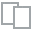
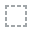
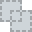
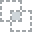
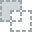
...
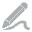
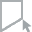
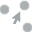
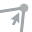
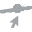

In [127]:
create_report(df, display=['Overview', 'Variables', 'Missing Values'])

## Data High level overview takeaways

- Sample size of 10000 customers, which we can safely say are all differents as there are no duplicates in row number and customers ids. There may still be customers with more than one account, we will look into that later
- No missing values 
- Credit Score distribution is slightly skewed to the left, meaning we have more customers with lower credit scores and a fewer with even higher credit scores. The median should be less than the mean here. We also have about 3% of our customers with max credit score 
- It's the opposite for the age
- Half our customers are active, half are not active anymore. 
- Half our customers are in France, a Quarter in Germany, a Quarter in Spain
- 55% males, 45% females
- 70% have a credit card, 30% not
- 95% of our customers either have 1 or 2 products, spread evenly in between, the rest have 3 or 4 products, spread evenly as well
- The estimated salary seems to follow an uniform distribution. It seems we are as likely to find a customer with relatively high salary of 110k as finding a cusotmer with a relatively low salary of 20k 
- Aside from customers with 0 in balance (which could be a cofounding variable for exited clients?), the balance seems to follow a normal distribution, centered around 120, with a quite high standard deviation, to be calculated if we need to 
- **20% of our customers have churned. We have a case of imbalanced data, which is often the case when we analyse churn**

Now let's dive deeper into our features pattern, when we look at exited customers and not exited customers

# EDA

## Bivariate Analysis. Patterns analysis between target variable (has exited) and provided independent variables. Automated with custom functions

### Exited against numerical predictors

In [128]:
# Let's better organise our dataset

## Separating out different columns into various categories as defined above. Depending on the type of the predictor, different visualisations are going to be made
target_var = ['Exited']
cols_to_remove = ['RowNumber', 'CustomerId','Surname'] #We also remove Surname, as it may cause some ethics issue. + GDPR
num_feats = ['CreditScore', 'Age', 'Tenure', 'Balance', 'NumOfProducts', 'EstimatedSalary']
cat_feats = ['Geography', 'Gender', 'HasCrCard', 'IsActiveMember']

## Separating out target variable and removing the non-essential columns
y = df[target_var].values
df.drop(cols_to_remove, axis=1, inplace=True)

In [129]:
import seaborn as sns
import matplotlib.pyplot as plt

import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def eda_bivariate_binary_against_numerical(data, binary_target, predictor):
    # Create subplots for histogram, boxplot, and average plot
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))

    # Plot histogram distribution of the predictor across binary_target
    sns.histplot(data=data, x=predictor, hue=binary_target, multiple="stack", ax=axes[0])
    axes[0].set_title("Distribution of {} across {}".format(predictor, binary_target))

    # Plot boxplots of the predictor across binary_target
    sns.boxplot(data=data, x=binary_target, y=predictor, ax=axes[1])
    axes[1].set_title("Distribution of {} across {}".format(predictor, binary_target))

    # Calculate mean of the predictor per value of binary_target
    mean_values = data.groupby(binary_target)[predictor].mean()
    
    # Plot average value of the predictor per value of binary_target
    targets = data[binary_target].unique()
    bar_positions = np.arange(len(targets))
    bar_heights = [mean_values[t] for t in targets]
    
    axes[2].bar(bar_positions, bar_heights, color='blue')
    axes[2].set_xticks(bar_positions)
    axes[2].set_xticklabels(targets)
    axes[2].set_title("Average value of {} across {}".format(predictor, binary_target))

    # Display the mean values on top of each bar
    for i, height in enumerate(bar_heights):
        axes[2].text(i, height, round(height, 2), ha='center', va='bottom', color='black')

    # Adjust the layout and display the plots
    plt.tight_layout()
    plt.show()


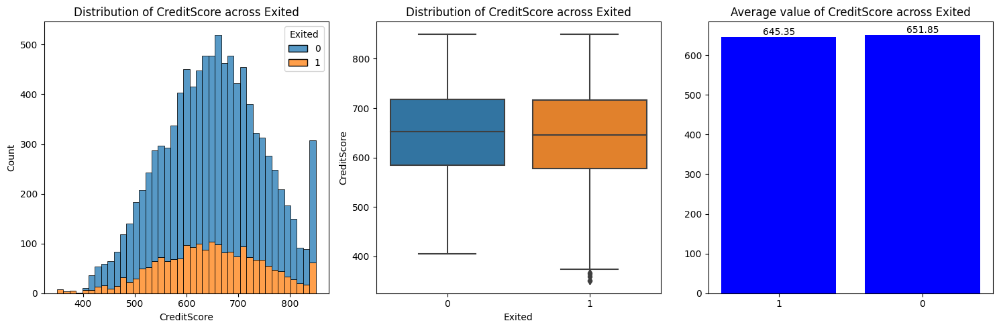

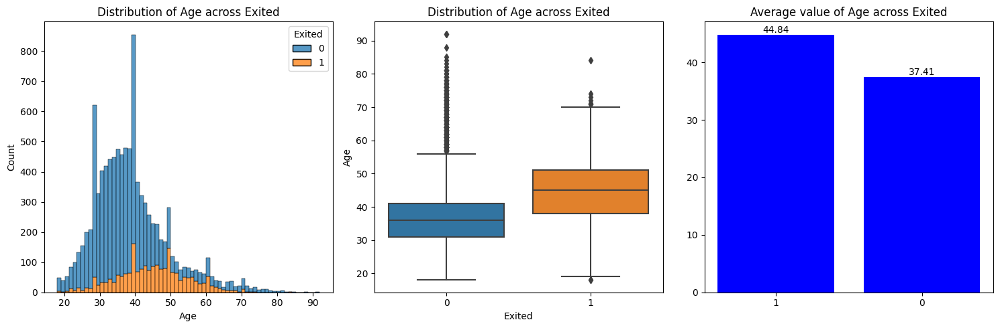

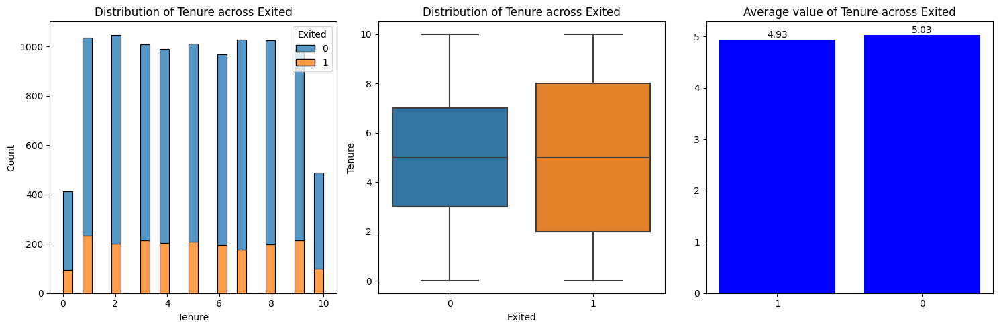

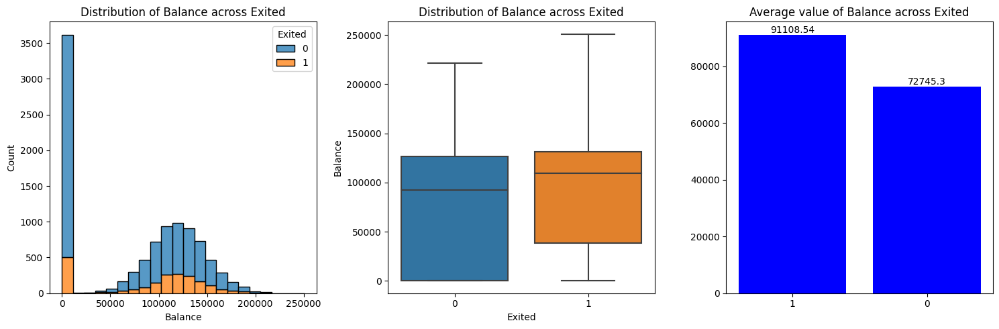

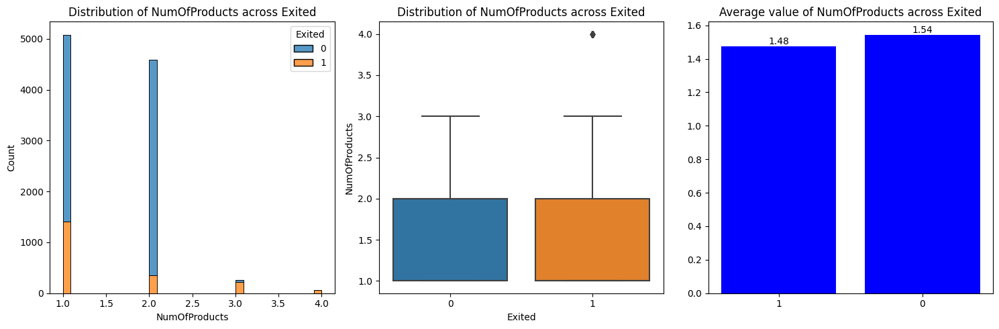

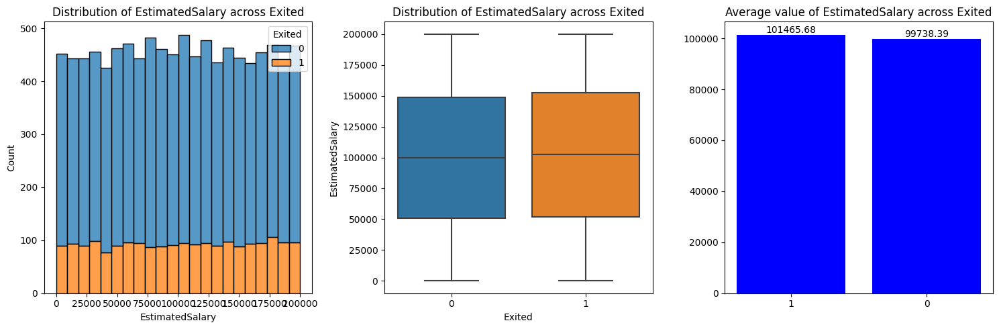

In [130]:
for num_feat in num_feats:
    eda_bivariate_binary_against_numerical(df,'Exited',num_feat)

### Takeaways

- Credit Score: ***Credit score does not seem to differ between churned and not churned customers***. Except if we look at the lowest and very low credit scores, where we mainly see exited customers. However the frequency is very low and in any case, retaining customers with very low customers can not be a business priority. There is a risk of overfit due to the very low amount of such customers. Also, some interrogation: Where their contract terminated due to the very low credit score or did they churn? 
- Age: ***We see a difference of patterns in age***. Churned customers age tend to follow a normal distribution with mean 45 years old, and a high standard deviation. Whereas when it comes to not exited customers, we see a surge of not exited customers at aroudn 35 years old. Could it be that the banks acquire many customers at this age, and these customers tend to spend like on average 10 years with the bank before churning? We also see that after 40 year old, until around 65 years old, the rate of churned customers compared to live customers is increasing. ***Maybe a variable such as "is_age_between_40_and_65" can be strongly associated with churn likelihood?***
- Tenure: ***We also see a slight difference of patterns in tenure*** Although on average exited and live cusotmers have similar tenure, *exited customers tend to relatively have more often very low and very high tenure*. ***Could it be that low tenure and high tenure***, meaning low or high amount of years of contract remaining, ***tend to have significant association with churn***. It could potentially make sense business wise, as ***it's harded to retain new customers right after acquisition, and at the end of a contract***. Also, if high tenure is associated with higher probability of churn, this can also help explain the drift we have between age of live customers and age of exited customers 
- Balance: If we exclude empty balances, the customer balance distribution is very similar between exited and live customers. However the most frequent balance amount is 0, for both exited and live customers. ***Can a 0 balance be associated with a customer not being active, and then a customer not being active associated with churn?*** We will try and visualise this later below. One of the limitations of the data, which we will also mention later below, is that ***we don't have time series data per customer id. We don't know if they first had 0 balance and then churned, or first 0 balance and then not active anymore and then churned. It's harder to understand the customer journey, and which steps seem more associated with churn. It will be harder to assess causality between events but we will do our best with what we have***
- Number of products: As we already mentioned above in the univariate analysis, 95% of the customers have two or less products. ***however most of the remaining 5%, which have more than 2 products, are exited customers***. Can it be that having two many products makes customer life too complicated? Can it be that those customers with high number of products, are very valuable clients in terms of balance and tenure, and that we should try and retain them as much as possible? In any case, ***we see an association*** We will dive deeper into those customers later 
- Salary: ***No pattern at all***. Salary does not seem to be associated with churn

### Follow up on above takeaways: 
- Let's see if adding a categorical variable "age between 40 and 60" can help find association with churn. 
- Let's also see if 0 balance is associated with customer not being active. and customer not being active associated with churn
- Finally, let's compute the % of exited customers per number of proructs. And also zoom in on those custoemrs with more than 2 products. Is having more than 2 products a cofounding variable of another one, the later being really associated with churn?

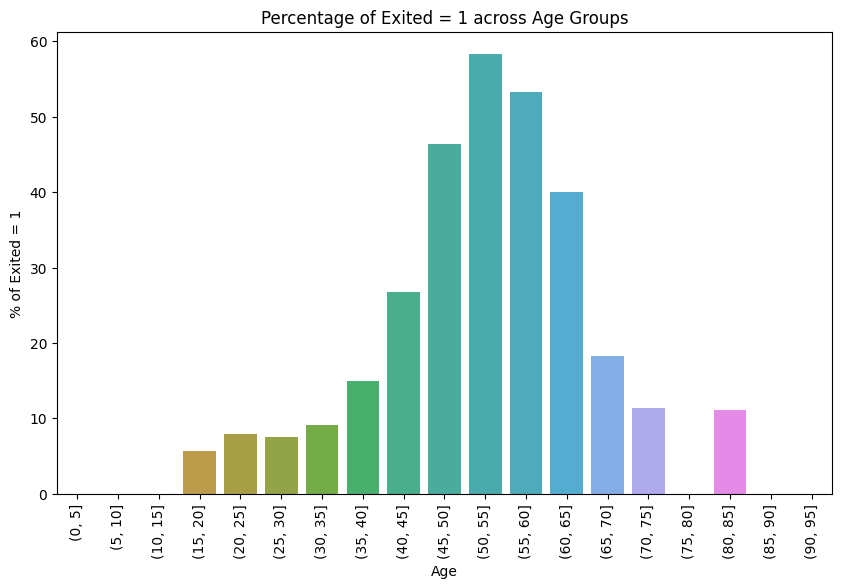

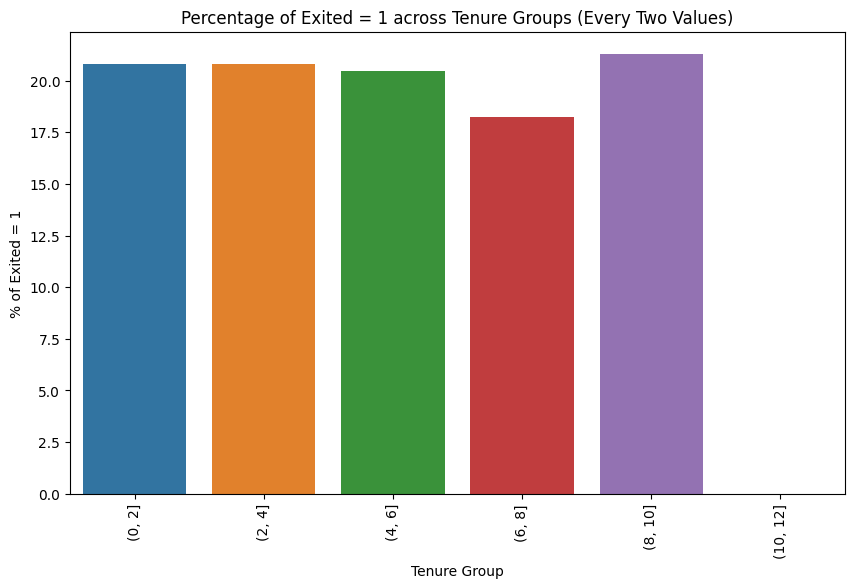

In [131]:
# Histogram - Percentage of 'Exited' equal to 1 across age groups
age_bins = range(0, df['Age'].max() + 6, 5)
df['Age_Group'] = pd.cut(df['Age'], bins=age_bins)
exit_percentage = df.groupby('Age_Group')['Exited'].mean() * 100

fig, ax = plt.subplots(figsize=(10, 6))
sns.barplot(x=exit_percentage.index, y=exit_percentage.values, ax=ax)
ax.set_xlabel('Age')
ax.set_ylabel('% of Exited = 1')
ax.set_title('Percentage of Exited = 1 across Age Groups')
plt.xticks(rotation=90)
plt.show();

# Create groups of every two values of Tenure
tenure_groups = range(0, df['Tenure'].max() + 3, 2)
df['Tenure_Group'] = pd.cut(df['Tenure'], bins=tenure_groups)

# Calculate the percentage of Exited = 1 for each group
exit_percentage = df.groupby('Tenure_Group')['Exited'].mean() * 100

fig, ax = plt.subplots(figsize=(10, 6))
sns.barplot(x=exit_percentage.index, y=exit_percentage.values, ax=ax)
ax.set_xlabel('Tenure Group')
ax.set_ylabel('% of Exited = 1')
ax.set_title('Percentage of Exited = 1 across Tenure Groups (Every Two Values)')
plt.xticks(rotation=90)
plt.show();



Indeed, when we look at customers aged between 50 and 60, the churn rate is above 50%. **This could be a good categorical variable to add for a logistic regression modelling**. Later we will try tree based models, and they can better handle these age thresholds, and by them selves

When it comes to Tenure, there is no clear pattern visually

Below we show that having a 0 balance is not associated in particular with becoming unactive. you can comment out the code to run it. And that, actually, the % of churned customers across those with money in the bank is higher than for those without (24% vs 13%). So maybe as well a categorical variable such as **is_balance_non_zero** can maybe help model the probability or churn

In [132]:
"""
zero_balance_df = df.loc[df["Balance"] == 0, ['Balance', 'Age', 'Tenure', 'IsActiveMember', 'Exited','NumOfProducts']]
non_zero_balance_df = df.loc[df["Balance"] > 0, ['Balance', 'Age', 'Tenure', 'IsActiveMember', 'Exited','NumOfProducts']]

zero_balance_report = create_report(zero_balance_df, display = ['Variables'])

non_zero_balance_report = create_report(non_zero_balance_df, display = ['Variables'])

zero_balance_report 
non_zero_balance_report
"""

'\nzero_balance_df = df.loc[df["Balance"] == 0, [\'Balance\', \'Age\', \'Tenure\', \'IsActiveMember\', \'Exited\',\'NumOfProducts\']]\nnon_zero_balance_df = df.loc[df["Balance"] > 0, [\'Balance\', \'Age\', \'Tenure\', \'IsActiveMember\', \'Exited\',\'NumOfProducts\']]\n\nzero_balance_report = create_report(zero_balance_df, display = [\'Variables\'])\n\nnon_zero_balance_report = create_report(non_zero_balance_df, display = [\'Variables\'])\n\nzero_balance_report \nnon_zero_balance_report\n'

**Below, when zooming on the customers with 3 or 4 products**, we see that they have similar balance as the rest of the population. However, they tend to be aged higher than the overall population, with a distribution quite normal centered around 44 years old. That's also a age with higher churn rate. They also tend to show higher unactivity rate compared to the overall population (56% vs 48%). We see some slight correlations with other candidate features such as age and unactivity, but not total identity so **this will be a feature to keep at first. And then potentially we can remove it later if we see it does not bring much more additional predictive power.**

To see the report, uncomment the code below

In [133]:
#more_than_two_products_df = df.loc[df["NumOfProducts"] > 2, ['Balance', 'Age', 'Tenure', 'IsActiveMember', 'Exited']]

#create_report(more_than_two_products_df, display = ['Variables'])

Is being unactive associated with churn? Let's start the bivariate analysis of target against categorical variables

### Exited against categorical predictors

In [134]:
# Automating bi variate analysis against categorical predictors. Proportion of target, and absolute amount of target 
def eda_bivariate_binary_against_categorical(data, binary_target, predictor):
    # Create subplots for proportion and count plots
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

    # Plot proportion of binary_target across predictor categories
    prop_data = data.groupby(predictor)[binary_target].value_counts(normalize=True).unstack()
    prop_data = prop_data.round(2)  # Round the proportions to 2 decimal places
    prop_data.plot(kind='bar', stacked=False, ax=axes[0], width=0.8)  # Set stacked=False and adjust width
    axes[0].set_title("Proportion of {} across {} categories".format(binary_target, predictor))
    axes[0].legend(title=binary_target)
    for p in axes[0].patches:
        axes[0].annotate(str(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()), ha='center',
                         va='bottom')

    # Plot absolute amount of binary_target across predictor categories
    count_data = data.groupby(predictor)[binary_target].value_counts().unstack()
    count_data.plot(kind='bar', stacked=False, ax=axes[1], width=0.8)  # Set stacked=False and adjust width
    axes[1].set_title("Absolute amount of {} across {} categories".format(binary_target, predictor))
    axes[1].legend(title=binary_target)
    for p in axes[1].patches:
        axes[1].annotate(str(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()), ha='center',
                         va='bottom')

    # Adjust the layout and display the plots
    plt.tight_layout()
    plt.show()

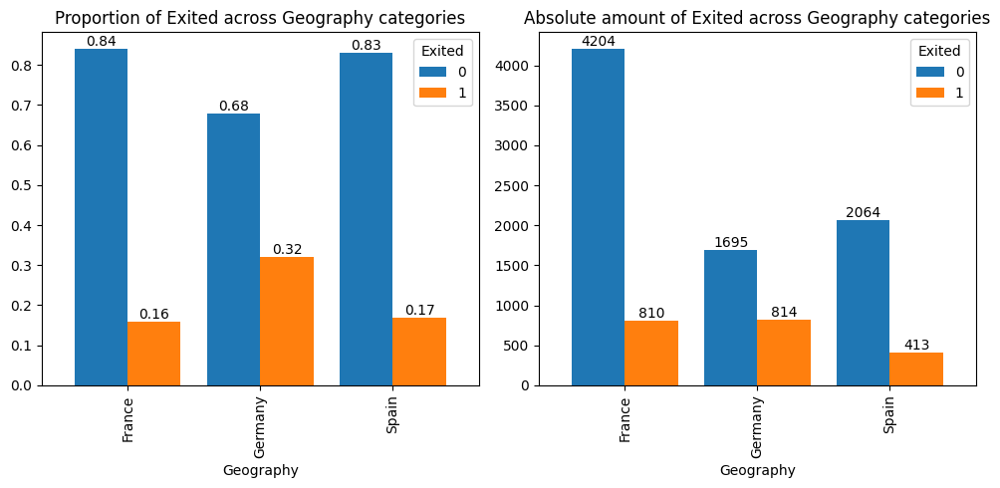

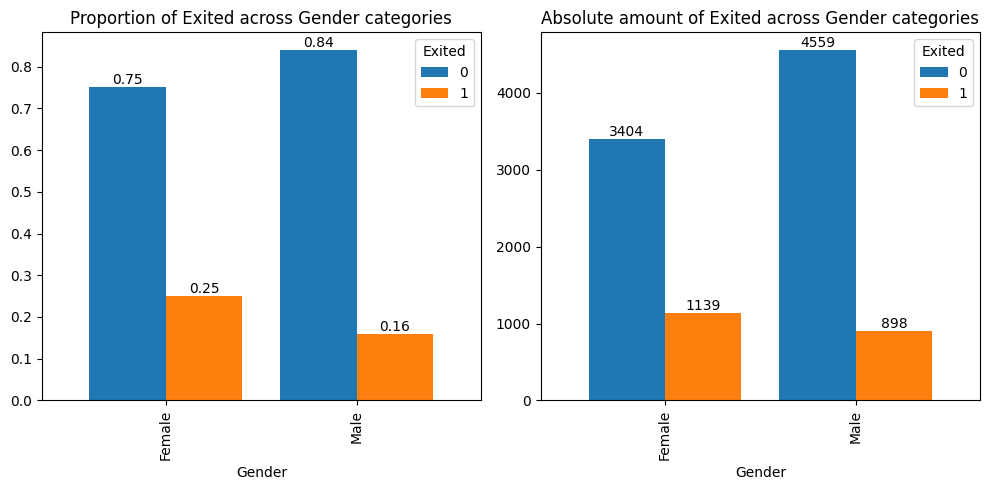

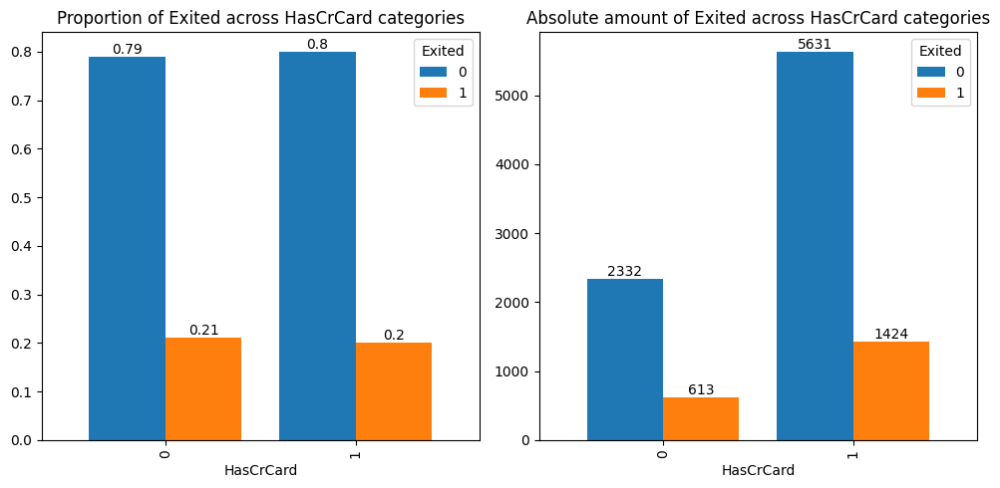

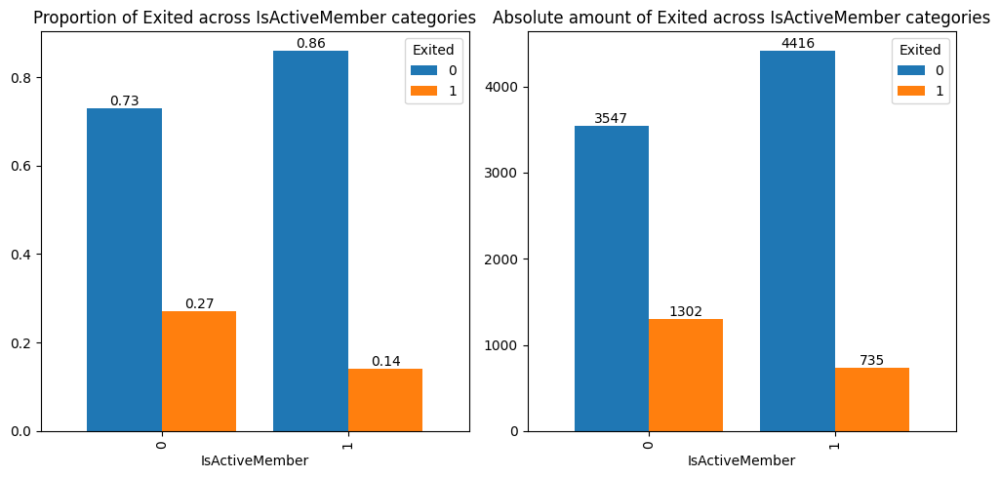

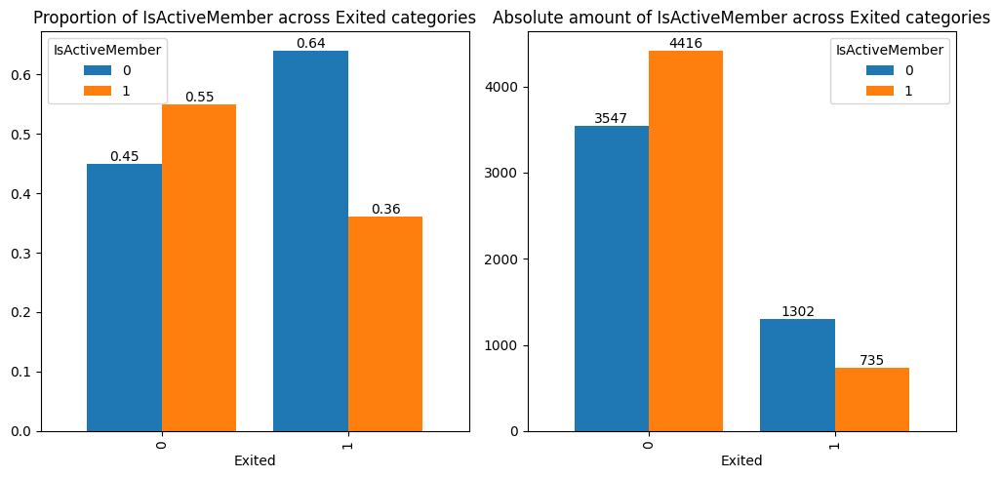

In [135]:
for cat_feat in cat_feats:
    eda_bivariate_binary_against_categorical(df, 'Exited', cat_feat)
    
eda_bivariate_binary_against_categorical(df, 'IsActiveMember', 'Exited')

### Takeaways

- The Churn rate seems to be higher in Germany and similar in France and in Spain. **A Is_In_Germany binary variable could make sense**
- Women seems 50% more likely to churn than men (25% churn rate vs 16% churn rate). **Gender seems also a variable to consider**
- The churn rate is the same across customer with or without credit cards. **We can discard this variable**
- The Churn rate for unactive member is twice the churn rate for active member. This makes sense business wise. Although, let's be sure of this: ***Is being unactive leading to churn, or is churning leading to being unactive***? 
- To check this, ***Let's see if all the churned customers are recorded as unactive***. And we still have 36% of the churned workers recorded as active. So it does really seem that ***is_active_member precedes is_churned, so we can use this variable to model the probability of churn***

## Feature engineering: Evaluate possible interactions

In [136]:
## Data with additional engineered features 

data = df.copy()

data["Age_45_65"] = data["Age"].apply(lambda age: int(age in range(45,66)))
data["3_or_4_products"] = data["NumOfProducts"].apply(lambda x: int((x == 3) or (x == 4)))
data["Zero_Balance"] = data["Balance"].apply(lambda x: int(x == 0))
data["From_Germany"] = data["Geography"].apply(lambda country: int(country == 'Germany'))
data["Is_Woman"] = data["Gender"].apply(lambda gender: int(gender == 'Female'))

## Potentially interesting interaction features 

eps = 1e-6

data['bal_per_product'] = data.Balance/(data.NumOfProducts + eps) #interaction between balance and product amounts 
data['tenure_age_ratio'] = data.Tenure/(data.Age + eps) # Maybe having a higher age compared to the tenure make us more likely to stay?

data

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Age_Group,Tenure_Group,Age_45_65,3_or_4_products,Zero_Balance,From_Germany,Is_Woman,bal_per_product,tenure_age_ratio
0,619,France,Female,42,2,0.00,1,1,1,101348.88,1,"(40, 45]","(0, 2]",0,0,1,0,1,0.000000,0.047619
1,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0,"(40, 45]","(0, 2]",0,0,0,0,1,83807.776192,0.024390
2,502,France,Female,42,8,159660.80,3,1,0,113931.57,1,"(40, 45]","(6, 8]",0,1,0,0,1,53220.248927,0.190476
3,699,France,Female,39,1,0.00,2,0,0,93826.63,0,"(35, 40]","(0, 2]",0,0,1,0,1,0.000000,0.025641
4,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0,"(40, 45]","(0, 2]",0,0,0,0,1,125510.694489,0.046512
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,771,France,Male,39,5,0.00,2,1,0,96270.64,0,"(35, 40]","(4, 6]",0,0,1,0,0,0.000000,0.128205
9996,516,France,Male,35,10,57369.61,1,1,1,101699.77,0,"(30, 35]","(8, 10]",0,0,0,0,0,57369.552630,0.285714
9997,709,France,Female,36,7,0.00,1,0,1,42085.58,1,"(35, 40]","(6, 8]",0,0,1,0,1,0.000000,0.194444
9998,772,Germany,Male,42,3,75075.31,2,1,0,92888.52,1,"(40, 45]","(2, 4]",0,0,0,1,0,37537.636231,0.071429


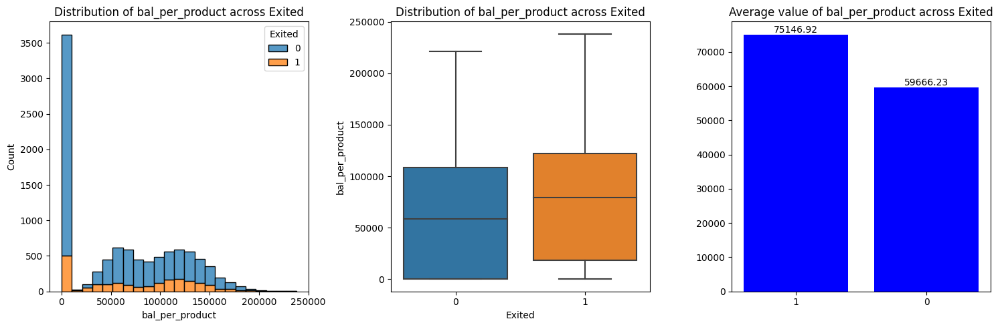

In [137]:
eda_bivariate_binary_against_numerical(data, 'Exited', 'bal_per_product')

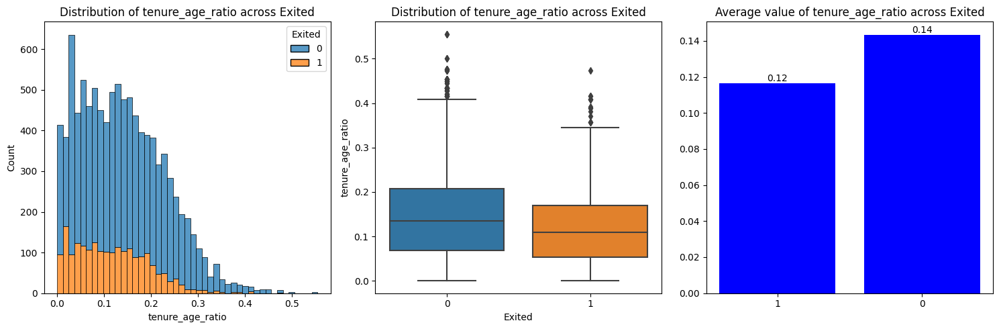

In [138]:
eda_bivariate_binary_against_numerical(data, 'Exited', 'tenure_age_ratio')

## Correlation matrix

DataPrep Report
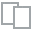
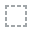
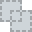
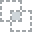
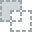
...
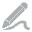
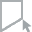
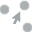
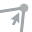
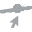

In [139]:
create_report(data, display = ['Correlations'])

## EDA conclusion, candidate features

- Age: It's one of the features among with the distribution differ quite much between churned and current customers. Especially, being aged between 45 and 65 years old seem to have strong association with churn 
- Tenure Age Ratio: The lower, the higher the churn rate
- Balance: It seems that having a balance stricly superior to 0 is associated with higher churn rate than empty balances. And we don't see that zero_balances customers are either younger, have less tenure, than clients with more than zero balances (it could have been that clients with zero balances for the most part were new clients). So it does not seem to be a cofounding factor, we will add it to the feature set for now 
- It seems that Higher balance per products is associated with more churn. We can start with a variable with is balance zero, and otherwise balance per products
- Number of Products: There is a strong churn rate for customers with 3 or 4 products within the bank. And after analysis, it does not seem that this variable is perfectly correlated with Age, or IsActiveMember, or Balance, so we will keep it for now. 
- Geography: German customers have twice the churn rate of French and Spanish customers. They also are around 2500 customers, so it's a pattern 
- IsActiveMember: It seems that becoming unactive is associated with Churn, which makes sense. And this is not because all churned customers are unactive.
- Gender: it seems that there is a higher churn rate for Female than Male
- All the other variables show no pattern with the probability of churn, so we will discard them 

## Limitations: Questioning the data

 - No date/time column. A lot of useful features can be built using date/time columns
 - When was the data snapshot taken? There are certain customer features like : Balance, Tenure, NumOfProducts, EstimatedSalary, which will have different values across time
 - Are all these values/features pertaining to the same single date or spread across multiple dates?
 - How frequently are customer features updated?
 - Will it be possible to have the values of these features over a period of time as opposed to a single, snapshot date?
 - Some customers who have exited still have balance in their account, or a non-zero NumOfProducts. Does this mean they have churned only from a specific product and not the entire bank, or are these snapshots of just before they churned?
 - Some features like, number and kind of transactions, can help us estimate the degree of activity of the customer, instead of trusting the binary variable IsActiveMember
 - Customer transaction patterns can also help us ascertain whether the customer has actually churned or not. For example, a customer might transact daily/weekly vs a customer who transacts annuallly
 
 ***These are potential improvement points of our model. Not only improving the model, but the data as well***

# Dataset final preprocessing before modelling. Missing values, outliers, feature engineering, train val test split 

### Filtering the dataset on chosen set of features

In [140]:
features = ["Age_45_65","3_or_4_products", "Zero_Balance",'bal_per_product','tenure_age_ratio','Gender', 'Geography', 'IsActiveMember']

df2 = data[features + ['Exited']]

df2.head(10)

,Age_45_65,3_or_4_products,Zero_Balance,bal_per_product,tenure_age_ratio,Gender,Geography,IsActiveMember,Exited
0,0,0,1,0.000000,0.047619,Female,France,1,1
1,0,0,0,83807.776192,0.024390,Female,Spain,1,0
2,0,1,0,53220.248927,0.190476,Female,France,0,1
3,0,0,1,0.000000,0.025641,Female,France,0,0
4,0,0,0,125510.694489,0.046512,Female,Spain,1,0
5,0,0,0,56877.861561,0.181818,Male,Spain,0,1
6,1,0,1,0.000000,0.140000,Male,France,1,0
7,0,1,0,28761.677810,0.137931,Female,Germany,0,1
8,0,0,0,71025.499487,0.090909,Male,France,1,0
9,0,0,0,134603.745396,0.074074,Male,France,1,0


### Splititng between train, validation and test 

In [141]:
from sklearn.model_selection import train_test_split

#target variable
y = df2['Exited'].values
df2.drop(['Exited'], axis = 1, inplace = True)

## Keeping aside a test/holdout set
df2_train_val, df2_test, y_train_val, y_test = train_test_split(df2, y, test_size = 0.1, random_state = 42)

## Splitting into train and validation set
df2_train, df2_val, y_train, y_val = train_test_split(df2_train_val, y_train_val, test_size = 0.12, random_state = 42)

df2_train.shape, df2_val.shape, df2_test.shape, y_train.shape, y_val.shape, y_test.shape
np.mean(y_train), np.mean(y_val), np.mean(y_test)

((7920, 8), (1080, 8), (1000, 8), (7920,), (1080,), (1000,))

(0.20303030303030303, 0.22037037037037038, 0.191)

### Missing values and outlier treatment

- From univariate analysis, no outliers values were seen. Nothing too far off the general distributions of features 
- The dataset also presented no missing values

#### Feature transformation

We saw during the univariate analysis that most of the features were either uniform or very close to normal. Potentially applying a log to slightly skewed features such as credit score, or age, could help the model have better precision and recall, but this can be adressed later during the modelling tuning phase. Right now we are going to start from baselines and improve from there

### Automating data pre processing: Categorical encoding, feature scaling

* HasCrCard and IsActiveMember are already label encoded
* For Gender, a simple Label encoding should be fine.
* For Geography, since there are 3 levels, OneHotEncoding should do the trick

We fit only on train dataset as that's the only data we'll assume we have. We'll treat validation and test sets as unseen data. Hence, they can't be used for fitting the encoders.

#### Feature scaling

- This is helpful for LogReg, especially for KNN as it's a distance based algorithm
- Not so much for Tree models 
- We will create a feature scaling class which we will include in the pipeline we will build

In [142]:
from sklearn.base import BaseEstimator, TransformerMixin

##### Custom Encoder

In [143]:
class CategoricalEncoder(BaseEstimator, TransformerMixin):
    """ 
    Encodes categorical columns using LabelEncoding, OneHotEncoding and TargetEncoding.
    LabelEncoding is used for binary categorical columns
    OneHotEncoding is used for columns with <= 10 distinct values
    TargetEncoding is used for columns with higher cardinality (>10 distinct values)
    
    """

    def __init__(self, cols = None, lcols = None, ohecols = None, reduce_df = True):
        """
        
        Parameters
        ----------
        cols : list of str
            Columns to encode.  Default is to one-hot/target/label encode all categorical columns in the DataFrame.
        reduce_df : bool
            Whether to use reduced degrees of freedom for encoding
            (that is, add N-1 one-hot columns for a column with N 
            categories). E.g. for a column with categories A, B, 
            and C: When reduce_df is True, A=[1, 0], B=[0, 1],
            and C=[0, 0].  When reduce_df is False, A=[1, 0, 0], 
            B=[0, 1, 0], and C=[0, 0, 1]
            Default = False
        
        """
        
        if isinstance(cols,str):
            self.cols = [cols]
        else :
            self.cols = cols
        
        if isinstance(lcols,str):
            self.lcols = [lcols]
        else :
            self.lcols = lcols
        
        if isinstance(ohecols,str):
            self.ohecols = [ohecols]
        else :
            self.ohecols = ohecols
        
        self.reduce_df = reduce_df
    
    
    def fit(self, X, y):
        """Fit label/one-hot/target encoder to X and y
        
        Parameters
        ----------
        X : pandas DataFrame, shape [n_samples, n_columns]
            DataFrame containing columns to encode
        y : pandas Series, shape = [n_samples]
            Target values.
            
        Returns
        -------
        self : encoder
            Returns self.
        """
        
        # Encode all categorical cols by default
        if self.cols is None:
            self.cols = [c for c in X if str(X[c].dtype)=='object']

        # Check columns are in X
        for col in self.cols:
            if col not in X:
                raise ValueError('Column \''+col+'\' not in X')
        
        # Separating out lcols, ohecols and tcols
        if self.lcols is None:
            self.lcols = [c for c in self.cols if X[c].nunique() <= 2]
        
        if self.ohecols is None:
            self.ohecols = [c for c in self.cols if ((X[c].nunique() > 2) & (X[c].nunique() <= 10))]
        
        
        ## Create Label Encoding mapping
        self.lmaps = dict()
        for col in self.lcols:
            self.lmaps[col] = dict(zip(X[col].values, X[col].astype('category').cat.codes.values))
        
        
        ## Create OneHot Encoding mapping
        self.ohemaps = dict() #dict to store map for each column
        for col in self.ohecols:
            self.ohemaps[col] = []
            uniques = X[col].unique()
            for unique in uniques:
                self.ohemaps[col].append(unique)
            if self.reduce_df:
                del self.ohemaps[col][-1]
        
        
        
        ## Return the fit object
        return self
    
    
    def transform(self, X, y=None):
        """Perform label/one-hot/target encoding transformation.
        
        Parameters
        ----------
        X : pandas DataFrame, shape [n_samples, n_columns]
            DataFrame containing columns to label encode
            
        Returns
        -------
        pandas DataFrame
            Input DataFrame with transformed columns
        """
        
        Xo = X.copy()
        ## Perform label encoding transformation
        for col, lmap in self.lmaps.items():
            
            # Map the column
            Xo[col] = Xo[col].map(lmap)
            Xo[col].fillna(-1, inplace=True) ## Filling new values with -1
        
        
        ## Perform one-hot encoding transformation
        for col, vals in self.ohemaps.items():
            for val in vals:
                new_col = col+'_'+str(val)
                Xo[new_col] = (Xo[col]==val).astype('uint8')
            del Xo[col]
        
        
        ## Return encoded DataFrame
        return Xo
    
    
    def fit_transform(self, X, y=None):
        """Fit and transform the data via label/one-hot/target encoding.
        
        Parameters
        ----------
        X : pandas DataFrame, shape [n_samples, n_columns]
            DataFrame containing columns to encode
        y : pandas Series, shape = [n_samples]
            Target values (required!).

        Returns
        -------
        pandas DataFrame
            Input DataFrame with transformed columns
        """
        
        return self.fit(X, y).transform(X, y)


##### Custom Scaler

In [144]:
class CustomScaler(BaseEstimator, TransformerMixin):
    """
    A custom standard scaler class with the ability to apply scaling on selected columns
    """
    
    def __init__(self, scale_cols = None):
        """
        Parameters
        ----------
        scale_cols : list of str
            Columns on which to perform scaling and normalization. Default is to scale all numerical columns
        
        """
        self.scale_cols = scale_cols
    
    
    def fit(self, X, y=None):
        """
        Parameters
        ----------
        X : pandas DataFrame, shape [n_samples, n_columns]
            DataFrame containing columns to scale
        """
        
        # Scaling all non-categorical columns if user doesn't provide the list of columns to scale
        if self.scale_cols is None:
            self.scale_cols = [c for c in X if ((str(X[c].dtype).find('float') != -1) or (str(X[c].dtype).find('int') != -1))]
        
     
        ## Create mapping corresponding to scaling and normalization
        self.maps = dict()
        for col in self.scale_cols:
            self.maps[col] = dict()
            self.maps[col]['mean'] = np.mean(X[col].values).round(2)
            self.maps[col]['std_dev'] = np.std(X[col].values).round(2)
        
        # Return fit object
        return self
    
    
    def transform(self, X):
        """
        Parameters
        ----------
        X : pandas DataFrame, shape [n_samples, n_columns]
            DataFrame containing columns to scale
        """
        Xo = X.copy()
        
        ## Map transformation to respective columns
        for col in self.scale_cols:
            Xo[col] = (Xo[col] - self.maps[col]['mean']) / self.maps[col]['std_dev']
        
        
        # Return scaled and normalized DataFrame
        return Xo
    
    
    def fit_transform(self, X, y=None):
        """
        Parameters
        ----------
        X : pandas DataFrame, shape [n_samples, n_columns]
            DataFrame containing columns to scale
        """
        # Fit and return transformed dataframe
        return self.fit(X).transform(X)
    
    

#### Automate model summary, residuals analysis and visualisation, for baselines models

In [145]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from statsmodels.stats.outliers_influence import variance_inflation_factor

def analyze_model(model, X, y):
    if isinstance(model, (LogisticRegression, sm.Logit)):
        # Model is logistic or linear regression
        if isinstance(model, LogisticRegression):
            # Convert scikit-learn logistic regression model to statsmodels format
            model = sm.Logit(y, sm.add_constant(X))
        result = model.fit()
        print(result.summary())
        
        if isinstance(model, LogisticRegression) or isinstance(model, sm.Logit):
            # Perform VIF analysis for both linear and logistic regression models
            vif = pd.DataFrame()
            vif["Variable"] = X.columns
            vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
            print("VIF Analysis:")
            print(vif)
        
        if not isinstance(model, LogisticRegression) and not isinstance(model, sm.Logit):
            # Perform residuals analysis only for linear regression models
            predictions = result.predict()
            residuals = y - predictions
            plt.scatter(predictions, residuals)
            plt.axhline(y=0, color='r', linestyle='--')
            plt.xlabel('Predicted Values')
            plt.ylabel('Residuals')
            plt.title('Residuals Analysis')
            plt.show()
            
    elif isinstance(model, DecisionTreeClassifier):
        # Model is a decision tree classifier
        importance = model.feature_importances_
        print("Feature Importance:")
        for feature, importance_score in zip(X.columns, importance):
            print(f"{feature}: {importance_score}")
        
        plt.figure(figsize=(18, 12))
        plot_tree(model, filled=True, rounded=True, feature_names=X.columns, class_names=True)
        plt.title("Decision Tree Visualization")

        # Increase font size of text in tree visualization
        ax = plt.gca()
        for text in ax.texts:
            text.set_fontsize(10)  # Adjust the font size as needed

        plt.show()
    else:
        print("Model type not supported for analysis.")


# Modelling 

## Baselines: Logistic Regression, Decision tree 

### Logistic Regression L2

In [146]:
from sklearn.pipeline import Pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression

## Importing relevant metrics
from sklearn.metrics import roc_auc_score, f1_score, recall_score, confusion_matrix, classification_report

In [147]:
cols_to_scale = ['bal_per_product', 'tenure_age_ratio']

In [148]:
## Defining model
lr = LogisticRegression(C = 1.0, penalty = 'l2', n_jobs = -1)

In [149]:
# Define the logreg pipeline
baseline_logreg_model = Pipeline(steps=[
    ('categorical_encoding', CategoricalEncoder(cols=['Gender', 'Geography'],lcols=['Gender'],ohecols=['Geography'])),
    ('standard_scaling', CustomScaler(cols_to_scale)),
    ('logreg', lr)
])

In [150]:
df2_train

,Age_45_65,3_or_4_products,Zero_Balance,bal_per_product,tenure_age_ratio,Gender,Geography,IsActiveMember
4562,0,0,0,58932.395534,0.027778,Male,Germany,0
6498,0,0,0,125167.614832,0.185185,Female,France,0
6072,1,0,1,0.000000,0.200000,Male,France,1
5813,0,0,1,0.000000,0.166667,Male,France,0
7407,0,0,1,0.000000,0.181818,Male,France,0
...,...,...,...,...,...,...,...,...
9296,1,0,0,50390.849805,0.160714,Female,Germany,1
3645,1,0,1,0.000000,0.054545,Male,France,1
5008,0,0,0,120037.839962,0.111111,Male,France,0
4343,1,0,0,92877.237123,0.092593,Male,Germany,0


In [151]:
# Fit pipeline with training data
baseline_logreg_model.fit(df2_train,y_train)

Pipeline(steps=[('categorical_encoding',
                 CategoricalEncoder(cols=['Gender', 'Geography'],
                                    lcols=['Gender'], ohecols=['Geography'])),
                ('standard_scaling',
                 CustomScaler(scale_cols=['bal_per_product',
                                          'tenure_age_ratio'])),
                ('logreg', LogisticRegression(n_jobs=-1))])

In [152]:
# Statistical summary of baseline logistic regression model 

# Getting the processed training dataset
data_processing_pipeline = Pipeline(steps=[
    ('categorical_encoding', CategoricalEncoder(cols=['Gender', 'Geography'],lcols=['Gender'],ohecols=['Geography'])),
    ('standard_scaling', CustomScaler(cols_to_scale))])

df2_train_processed = data_processing_pipeline.fit_transform(df2_train)

# Getting the model from the pipeline
logreg_model = baseline_logreg_model.named_steps['logreg']

# Analysis of baseline logistic regression model

analyze_model(logreg_model, df2_train_processed, y_train)

Optimization terminated successfully.
         Current function value: 0.381552
         Iterations 7
                           Logit Regression Results                           
Dep. Variable:                      y   No. Observations:                 7920
Model:                          Logit   Df Residuals:                     7910
Method:                           MLE   Df Model:                            9
Date:                Tue, 06 Jun 2023   Pseudo R-squ.:                  0.2438
Time:                        22:33:24   Log-Likelihood:                -3021.9
converged:                       True   LL-Null:                       -3996.2
Covariance Type:            nonrobust   LLR p-value:                     0.000
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                -1.7575      0.102    -17.223      0.000      -1.958      -1.558
Age_45_6

- Having 3 or 4 products, and being in an Age between 45 and 65 ye seems to have stronger association with the log odds of churning
- No strong, problematic multicollinearity. Safer interperetations of coefficients estimates and confidence intervals 

In [153]:
# Predict target values on val data

df2_val_processed = data_processing_pipeline.transform(df2_val)

val_preds = logreg_model.predict(df2_val_processed)

In [154]:
## Validation metrics
roc_auc_score(y_val, val_preds)
recall_score(y_val, val_preds)
confusion_matrix(y_val, val_preds)
print(classification_report(y_val, val_preds))

0.6598884209265654

0.36134453781512604

array([[807,  35],
       [152,  86]])

              precision    recall  f1-score   support

           0       0.84      0.96      0.90       842
           1       0.71      0.36      0.48       238

    accuracy                           0.83      1080
   macro avg       0.78      0.66      0.69      1080
weighted avg       0.81      0.83      0.80      1080



- Baseline show relatively strong precision but low recall, leading to an unsatisfactory f1 score. 
- Especially in this banking churn use case, we may be especially in having a stronger recall than precision

### Decision tree

In [155]:
clf = DecisionTreeClassifier(criterion = 'entropy', max_depth = 4, max_features = None
                            , min_samples_split = 25, min_samples_leaf = 15)

In [156]:
model = Pipeline(steps = [('categorical_encoding', CategoricalEncoder()),
                          ('classifier', clf)
                         ])

# Fit pipeline with training data
model.fit(df2_train,y_train)

Pipeline(steps=[('categorical_encoding',
                 CategoricalEncoder(cols=['Gender', 'Geography'],
                                    lcols=['Gender'], ohecols=['Geography'])),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=4,
                                        min_samples_leaf=15,
                                        min_samples_split=25))])

Feature Importance:
Age_45_65: 0.45953589506033365
3_or_4_products: 0.2435445750977101
Zero_Balance: 0.0
bal_per_product: 0.06674104399803461
tenure_age_ratio: 0.0
Gender: 0.002902433553418999
IsActiveMember: 0.12331411726199544
Geography_Germany: 0.10396193502850724
Geography_France: 0.0


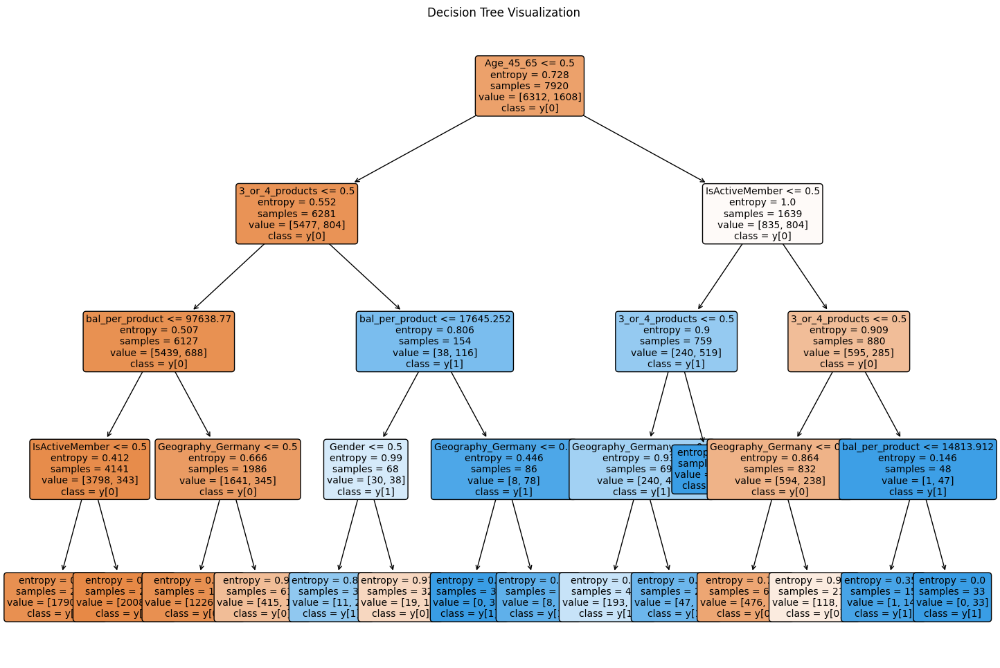

In [157]:
# Analysis of baseline tree classifier model

encoder = CategoricalEncoder()

df2_train_clf_processed = encoder.fit_transform(df2_train)

analyze_model(clf, df2_train_processed, y_train)

In [158]:
# Predict target values on val data
val_preds_clf = clf.predict(encoder.transform(df2_val))

In [159]:
## Validation metrics
roc_auc_score(y_val, val_preds_clf)
recall_score(y_val, val_preds_clf)
confusion_matrix(y_val, val_preds_clf)
print(classification_report(y_val, val_preds_clf))

0.6656420287830096

0.38235294117647056

array([[799,  43],
       [147,  91]])

              precision    recall  f1-score   support

           0       0.84      0.95      0.89       842
           1       0.68      0.38      0.49       238

    accuracy                           0.82      1080
   macro avg       0.76      0.67      0.69      1080
weighted avg       0.81      0.82      0.80      1080



- similar recall as log reg 
- lower precision but slighly higher f1 score

Decision tree as baseline performance. 

**36% recall, 68 % precision, 49% f1-score**

## Let's improve our baseline scores 

- Change our variables and retry on our baseline models. I am thinking that the Age 45_65 variables and especially the 3_4 products (very small sample size) variable have especially responsible for increasing precision over recall 
- Change the weights of our data points, add more weight to churned customers. Penalise model for not predicting if a customer will churn, when we did, to achieve more recall
- Let's try other models. And let's try K fold cross validation

### Update on our baselines: Using less precise features to achieve more recall

Spoiler Alert: This made the recall problem worse

In [160]:
# Updating the dataset 

edited_features = ["Zero_Balance", "Age","NumOfProducts", 'bal_per_product','tenure_age_ratio','Gender', 'Geography', 'IsActiveMember'] #from age4565 to age, from 3_4 products to num of products

df_edited = data[edited_features + ['Exited']]

#target variable
y = df_edited['Exited'].values
df_edited.drop(['Exited'], axis = 1, inplace = True)

## Keeping aside a test/holdout set
df_edited_train_val, df_edited_test, y_edited_train_val, y_edited_test = train_test_split(df_edited, y.ravel(), test_size = 0.1, random_state = 42)

## Splitting into train and validation set
df_edited_train, df_edited_val, y_edited_train, y_edited_val = train_test_split(df_edited_train_val, y_edited_train_val, test_size = 0.12, random_state = 42)

In [161]:
df_edited_train.dtypes

Zero_Balance          int64
Age                   int64
NumOfProducts         int64
bal_per_product     float64
tenure_age_ratio    float64
Gender               object
Geography            object
IsActiveMember        int64
dtype: object

In [162]:
model = Pipeline(steps = [('categorical_encoding', CategoricalEncoder()),
                          ('classifier', clf)
                         ])

# Fit pipeline with training data
model.fit(df_edited_train,y_edited_train)

# Predict target values on val data
val_preds_clf = clf.predict(encoder.transform(df_edited_val))

## Validation metrics
roc_auc_score(y_edited_val, val_preds_clf)
recall_score(y_edited_val, val_preds_clf)
confusion_matrix(y_edited_val, val_preds_clf)
print(classification_report(y_edited_val, val_preds_clf))


Pipeline(steps=[('categorical_encoding',
                 CategoricalEncoder(cols=['Gender', 'Geography'],
                                    lcols=['Gender'], ohecols=['Geography'])),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=4,
                                        min_samples_leaf=15,
                                        min_samples_split=25))])

0.6294287311123974

0.27310924369747897

array([[830,  12],
       [173,  65]])

              precision    recall  f1-score   support

           0       0.83      0.99      0.90       842
           1       0.84      0.27      0.41       238

    accuracy                           0.83      1080
   macro avg       0.84      0.63      0.66      1080
weighted avg       0.83      0.83      0.79      1080



### Put more weights on churned customers 

Spoiler alert: it helped a lot 

In [163]:
# With the precise features

weights_dict = {0 : 1.0, 1 : 3.92}

weighted_clf = DecisionTreeClassifier(criterion = 'entropy', class_weight = weights_dict, max_depth = 4, max_features = None
                            , min_samples_split = 25, min_samples_leaf = 15)

weighted_model = Pipeline(steps = [('categorical_encoding', CategoricalEncoder()),
                          ('classifier', weighted_clf)
                         ])

# Fit pipeline with training data
weighted_model.fit(df2_train,y_train)

# Predict target values on val data
val_preds_weighted_clf = weighted_clf.predict(encoder.transform(df2_val))

## Validation metrics
roc_auc_score(y_val, val_preds_weighted_clf)
recall_score(y_val, val_preds_weighted_clf)
confusion_matrix(y_val, val_preds_weighted_clf)
print(classification_report(y_val, val_preds_weighted_clf))


Pipeline(steps=[('categorical_encoding',
                 CategoricalEncoder(cols=['Gender', 'Geography'],
                                    lcols=['Gender'], ohecols=['Geography'])),
                ('classifier',
                 DecisionTreeClassifier(class_weight={0: 1.0, 1: 3.92},
                                        criterion='entropy', max_depth=4,
                                        min_samples_leaf=15,
                                        min_samples_split=25))])

0.7456885366973393

0.6932773109243697

array([[672, 170],
       [ 73, 165]])

              precision    recall  f1-score   support

           0       0.90      0.80      0.85       842
           1       0.49      0.69      0.58       238

    accuracy                           0.78      1080
   macro avg       0.70      0.75      0.71      1080
weighted avg       0.81      0.78      0.79      1080



In [164]:
# With the edited less precise features

weights_dict = {0 : 1.0, 1 : 3.92}

weighted_clf = DecisionTreeClassifier(criterion = 'entropy', class_weight = weights_dict, max_depth = 4, max_features = None
                            , min_samples_split = 25, min_samples_leaf = 15)

weighted_model = Pipeline(steps = [('categorical_encoding', CategoricalEncoder()),
                          ('classifier', weighted_clf)
                         ])

# Fit pipeline with training data
weighted_model.fit(df_edited_train,y_edited_train)

# Predict target values on val data
val_preds_weighted_clf = weighted_clf.predict(encoder.transform(df_edited_val))

# Predict target values on train data
train_preds_weighted_clf = weighted_clf.predict(encoder.transform(df_edited_train))

## Validation metrics
roc_auc_score(y_edited_val, val_preds_weighted_clf)
recall_score(y_edited_val, val_preds_weighted_clf)
confusion_matrix(y_edited_val, val_preds_weighted_clf)
print(classification_report(y_edited_val, val_preds_weighted_clf))

## Validation metrics training
roc_auc_score(y_edited_train, train_preds_weighted_clf)
recall_score(y_edited_train, train_preds_weighted_clf)
confusion_matrix(y_edited_train, train_preds_weighted_clf)
print(classification_report(y_edited_train, train_preds_weighted_clf))


Pipeline(steps=[('categorical_encoding',
                 CategoricalEncoder(cols=['Gender', 'Geography'],
                                    lcols=['Gender'], ohecols=['Geography'])),
                ('classifier',
                 DecisionTreeClassifier(class_weight={0: 1.0, 1: 3.92},
                                        criterion='entropy', max_depth=4,
                                        min_samples_leaf=15,
                                        min_samples_split=25))])

0.7477394758378411

0.7436974789915967

array([[633, 209],
       [ 61, 177]])

              precision    recall  f1-score   support

           0       0.91      0.75      0.82       842
           1       0.46      0.74      0.57       238

    accuracy                           0.75      1080
   macro avg       0.69      0.75      0.70      1080
weighted avg       0.81      0.75      0.77      1080



0.7514707829672929

0.7369402985074627

array([[4835, 1477],
       [ 423, 1185]])

              precision    recall  f1-score   support

           0       0.92      0.77      0.84      6312
           1       0.45      0.74      0.56      1608

    accuracy                           0.76      7920
   macro avg       0.68      0.75      0.70      7920
weighted avg       0.82      0.76      0.78      7920



**Substantial increase in recall to the weighting. Using less precise features also helped the recall when applying weights** 

**New baseline: 74% Recall, 57% f1 score**

### Other, more powerful tree models. Bagging, Boosting. K fold cross validation

Models : RF, LGBM, XGB

In [165]:
from sklearn.model_selection import cross_val_score

In [166]:
## Preparing data and a few common model parameters
X = data[features]
X_2 = data[edited_features]
y

weights_dict = {0 : 1.0, 1 : 3.93}

array([1, 0, 1, ..., 1, 1, 0])

In [167]:
#!pip install wheel
#!pip install lightgbm
#!pip install xgboost

## Importing the models to be tried out
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
#from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB, MultinomialNB, ComplementNB, BernoulliNB

In [168]:
## Preparing a list of models to try out in the spot-checking process
def model_zoo(models = dict()):
    # Tree models

    
    for n_trees in [21, 1001]:
        models['rf_' + str(n_trees)] = RandomForestClassifier(n_estimators = n_trees, n_jobs = -1, criterion = 'entropy'
                                                              , class_weight = weights_dict, max_depth = 6, max_features = 0.6
                                                              , min_samples_split = 30, min_samples_leaf = 20)
        
        """models['lgb_' + str(n_trees)] = LGBMClassifier(boosting_type='dart', num_leaves=31, max_depth= 6, learning_rate=0.1
                                                       , n_estimators=n_trees, class_weight=weights_dict, min_child_samples=20
                                                       , colsample_bytree=0.6, reg_alpha=0.3, reg_lambda=1.0, n_jobs=- 1
                                                       , importance_type = 'gain')"""
        
        models['xgb_' + str(n_trees)] = XGBClassifier(objective='binary:logistic', n_estimators = n_trees, max_depth = 6
                                                      , learning_rate = 0.03, n_jobs = -1, colsample_bytree = 0.6
                                                      , reg_alpha = 0.3, reg_lambda = 0.1, scale_pos_weight = weights_dict[1])
        
        models['et_' + str(n_trees)] = ExtraTreesClassifier(n_estimators=n_trees, criterion = 'entropy', max_depth = 6
                                                            , max_features = 0.6, n_jobs = -1, class_weight = weights_dict
                                                            , min_samples_split = 30, min_samples_leaf = 20)
    
    """  # kNN models
    for n in [3,5,11]:
        models['knn_' + str(n)] = KNeighborsClassifier(n_neighbors=n)
    
    # Naive-Bayes models
    models['gauss_nb'] = GaussianNB()
    models['multi_nb'] = MultinomialNB()
    models['compl_nb'] = ComplementNB()
    models['bern_nb'] = BernoulliNB()"""
    
    return models

In [169]:
## Automation of data preparation and model run through pipelines
def make_pipeline(model):
    '''
    Creates pipeline for the model passed as the argument. Uses standard scaling only in case of kNN models. 
    Ignores scaling step for tree/Naive Bayes models
    '''
    
    if (str(model).find('KNeighborsClassifier') != -1):
        pipe =  Pipeline(steps = [('categorical_encoding', CategoricalEncoder()),
                              ('standard_scaling', CustomScaler(cols_to_scale)),
                              ('classifier', model)
                             ])
    else :
        pipe =  Pipeline(steps = [('categorical_encoding', CategoricalEncoder()),
                              ('classifier', model)
                             ])
    
    
    return pipe


In [170]:
## Run/Evaluate all 15 models using KFold cross-validation (5 folds)
def evaluate_models(X, y, models, folds = 5, metric = 'recall'):
    results = dict()
    for name, model in models.items():
        # Evaluate model through automated pipelines
        pipeline = make_pipeline(model)
        scores = cross_val_score(pipeline, X, y, cv = folds, scoring = metric, n_jobs = -1)
        
        # Store results of the evaluated model
        results[name] = scores
        mu, sigma = np.mean(scores), np.std(scores)
        # Printing individual model results
        print('Model {}: mean = {}, std_dev = {}'.format(name, mu, sigma))
    
    return results

In [171]:
np.random.seed(42)

## Spot-checking in action
models = model_zoo()
print('Recall metric')
results = evaluate_models(X_2, y , models, metric = 'recall')
print('F1-score metric')
results = evaluate_models(X_2, y , models, metric = 'f1')

Recall metric
Model rf_21: mean = 0.7113515922339452, std_dev = 0.02550354128678053
Model xgb_21: mean = 0.740302066772655, std_dev = 0.010969564682887597
Model et_21: mean = 0.7515801898154839, std_dev = 0.019427430062483098
Model rf_1001: mean = 0.7221467456761574, std_dev = 0.02649083680106932
Model xgb_1001: mean = 0.6696030254853784, std_dev = 0.02303477308396892
Model et_1001: mean = 0.7579587608999374, std_dev = 0.019347402026300392
F1-score metric
Model rf_21: mean = 0.587040248052831, std_dev = 0.008256304843349141
Model xgb_21: mean = 0.5792574035373719, std_dev = 0.011982208804951048
Model et_21: mean = 0.5738457961308268, std_dev = 0.01423324508871182
Model rf_1001: mean = 0.5939614367594922, std_dev = 0.005661329189584845
Model xgb_1001: mean = 0.5968148754493818, std_dev = 0.012585266852306213
Model et_1001: mean = 0.5752739943420567, std_dev = 0.011430200558501325


Based on the relevant metric, a suitable model can be chosen for further hyperparameter tuning.

***We will use the Extra Trees classifer for hyperparameter tuning, especially for the recall. We do slighly better than the previous decision tree classifier, wit similar 57% f1 score and 75 compared to 74% recall. Let's try and do even better with hyperparameter tuning***

### Hyperparameter tuning

- Will optimize on F1 metric. We could easily reach 75% Recall from the default parameters as seen earlier

In [172]:
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

#### Randomized Search

In [173]:
chosen_model = models['et_1001']

In [174]:
## Exhaustive list of parameters
parameters = {'n_estimators':[10, 21, 51, 100, 201, 350, 501,1001]
             ,'max_depth': [3, 4, 6, 9]
              ,'min_samples_split': [5,10,20,40, 80, 120, 160, 200, 240, 280, 320, 360, 400]
             ,'class_weight': [{0: 1.0, 1: 3.93}]
              , 'max_features':['log2','sqrt', 0.6, 0.5, 0.7]
             }

In [175]:
encoder = CategoricalEncoder()

X_2_encoded = encoder.fit_transform(X_2)

np.random.seed(42)

search = RandomizedSearchCV(chosen_model, parameters, n_iter = 20, cv = 5, scoring = 'f1')
search.fit(X_2_encoded, y)

RandomizedSearchCV(cv=5,
                   estimator=ExtraTreesClassifier(class_weight={0: 1.0,
                                                                1: 3.93},
                                                  criterion='entropy',
                                                  max_depth=6, max_features=0.6,
                                                  min_samples_leaf=20,
                                                  min_samples_split=30,
                                                  n_estimators=1001,
                                                  n_jobs=-1),
                   n_iter=20,
                   param_distributions={'class_weight': [{0: 1.0, 1: 3.93}],
                                        'max_depth': [3, 4, 6, 9],
                                        'max_features': ['log2', 'sqrt', 0.6,
                                                         0.5, 0.7],
                                        'min_samples_split': [5, 10, 20, 40, 80,
  

In [176]:
search.best_params_
search.best_score_

{'n_estimators': 51,
 'min_samples_split': 40,
 'max_features': 0.7,
 'max_depth': 6,
 'class_weight': {0: 1.0, 1: 3.93}}

0.5777771339230092

In [177]:
models['et_tuned'] = ExtraTreesClassifier(n_estimators=51, criterion = 'entropy', max_depth = 6
                                                            , max_features = 0.7, n_jobs = -1, class_weight = weights_dict
                                                            , min_samples_split = 40, min_samples_leaf = 20)
etc = ExtraTreesClassifier(n_estimators=51, criterion = 'entropy', max_depth = 6
                                                            , max_features = 0.7, n_jobs = -1, class_weight = weights_dict
                                                            , min_samples_split = 40, min_samples_leaf = 20)

In [178]:
np.random.seed(42)

## Spot-checking in action
models = model_zoo()
print('Recall metric')
results = evaluate_models(X_2, y , models, metric = 'recall')
print('F1-score metric')
results = evaluate_models(X_2, y , models, metric = 'f1')

Recall metric
Model rf_21: mean = 0.7206773618538325, std_dev = 0.02777297005560063
Model xgb_21: mean = 0.740302066772655, std_dev = 0.010969564682887597
Model et_21: mean = 0.7594377800260153, std_dev = 0.020572405276521433
Model rf_1001: mean = 0.7196945608710315, std_dev = 0.02847815621157054
Model xgb_1001: mean = 0.6696030254853784, std_dev = 0.02303477308396892
Model et_1001: mean = 0.7530495736378089, std_dev = 0.02219892114191862
Model et_tuned: mean = 0.7555053716818423, std_dev = 0.019643130129861942
F1-score metric
Model rf_21: mean = 0.5895902257136993, std_dev = 0.00473282077326899
Model xgb_21: mean = 0.5792574035373719, std_dev = 0.011982208804951048
Model et_21: mean = 0.5731665405024491, std_dev = 0.013732009136112236
Model rf_1001: mean = 0.5918780294713235, std_dev = 0.004827268236550211
Model xgb_1001: mean = 0.5968148754493818, std_dev = 0.012585266852306213
Model et_1001: mean = 0.5740112083515684, std_dev = 0.008858143584997582
Model et_tuned: mean = 0.578092047

#### GridsearchCV

We slightly improved on the recall and on the f1 score. Let's try out other estimators number and min_samples split. I am thinking we may potentially do even better in the validation set with higher amount of trees and tree max depth

In [179]:
## Exhaustive list of parameters
grid_parameters = {'n_estimators':[51, 101, 151, 201]
             ,'max_depth': [6,7,8]
            ,'class_weight': [{0: 1.0, 1: 3.93}]
            ,'min_samples_split': [10,20,30,40,50]
            ,'max_features': [0.7]}


In [180]:
grid = GridSearchCV(etc, grid_parameters, cv = 5, scoring = 'f1', n_jobs = -1)

grid.fit(X_2_encoded, y)

GridSearchCV(cv=5,
             estimator=ExtraTreesClassifier(class_weight={0: 1.0, 1: 3.93},
                                            criterion='entropy', max_depth=6,
                                            max_features=0.7,
                                            min_samples_leaf=20,
                                            min_samples_split=40,
                                            n_estimators=51, n_jobs=-1),
             n_jobs=-1,
             param_grid={'class_weight': [{0: 1.0, 1: 3.93}],
                         'max_depth': [6, 7, 8], 'max_features': [0.7],
                         'min_samples_split': [10, 20, 30, 40, 50],
                         'n_estimators': [51, 101, 151, 201]},
             scoring='f1')

In [181]:
grid.best_params_
grid.best_score_

{'class_weight': {0: 1.0, 1: 3.93},
 'max_depth': 8,
 'max_features': 0.7,
 'min_samples_split': 20,
 'n_estimators': 51}

0.5923544149170177

In [182]:
etc_grid = ExtraTreesClassifier(n_estimators=151, criterion = 'entropy', max_depth = 8
                                                            , max_features = 0.7, n_jobs = -1, class_weight = weights_dict
                                                            , min_samples_split = 30, min_samples_leaf = 20)
models['etc_grid'] = etc_grid

In [183]:
np.random.seed(42)

## Spot-checking in action
models = model_zoo()
print('Recall metric')
results = evaluate_models(X_2, y , models, metric = 'recall')
print('F1-score metric')
results = evaluate_models(X_2, y , models, metric = 'f1')

Recall metric
Model rf_21: mean = 0.7255745049862697, std_dev = 0.024351180800772757
Model xgb_21: mean = 0.740302066772655, std_dev = 0.010969564682887597
Model et_21: mean = 0.7574673604085368, std_dev = 0.021632053593670313
Model rf_1001: mean = 0.7231307510719276, std_dev = 0.02548945705303216
Model xgb_1001: mean = 0.6696030254853784, std_dev = 0.02303477308396892
Model et_1001: mean = 0.7559955677602737, std_dev = 0.019712676259010253
Model et_tuned: mean = 0.7535445873681168, std_dev = 0.019054940505193033
Model etc_grid: mean = 0.7540444187503011, std_dev = 0.007683375610637673
F1-score metric
Model rf_21: mean = 0.5847136580684718, std_dev = 0.006255680005863999
Model xgb_21: mean = 0.5792574035373719, std_dev = 0.011982208804951048
Model et_21: mean = 0.5716161207045706, std_dev = 0.008471761920978446
Model rf_1001: mean = 0.5928708877979021, std_dev = 0.004583872694971326
Model xgb_1001: mean = 0.5968148754493818, std_dev = 0.012585266852306213
Model et_1001: mean = 0.575195

***Through a combination of Random and Grid Search, we improved on the F1 score from 0.57 to 0.59, while keeping the recall at 0.75. We will keep this model for Error Analysis. Can we identify patterns on where the algorithm has been wrong, and from this learning, improve it further?***

### Error Analysis

#### Regathering and splitting the data between train val and test

In [184]:
## Keeping aside a test/holdout set
X_2_train_val, X_2_test, y_train_val, y_test = train_test_split(X_2, y, test_size = 0.1, random_state = 42)

## Splitting into train and validation set
X_2_train, X_2_val, y_train, y_val = train_test_split(X_2_train_val, y_train_val, test_size = 0.12, random_state = 42)

## doing the same with initial dataset. This will help have all the variables at the same place for error analysis

df_train_val, df_test, y_train_val, y_test = train_test_split(df, y, test_size = 0.1, random_state = 42)

## Splitting into train and validation set
df_train, df_val, y_train, y_val = train_test_split(df_train_val, y_train_val, test_size = 0.12, random_state = 42)

In [222]:
## Final model with best params for F1-score metric

final_model = Pipeline(steps = [('categorical_encoding', CategoricalEncoder(cols = ['Gender', 'Geography'])),
                          ('classifier', etc_grid)
                         ])

In [235]:
## Making predictions on a copy of validation set

df_ea = df_val.copy()

final_model.fit(X_2_train, y_train)

df_ea['y_pred'] = final_model.predict(X_2_val)
df_ea['y_pred_prob'] = final_model.predict_proba(X_2_val)[:,1]
df_ea['absolute_error'] = np.abs(df_ea['Exited'] - df_ea['y_pred_prob'])
df_ea['error_bin'] = np.ceil(df_ea['absolute_error'] * 4) / 4

df_ea = df_ea.sort_values('absolute_error', ascending = False)

df_ea.shape
df_ea.head(100)

Pipeline(steps=[('categorical_encoding',
                 CategoricalEncoder(cols=['Gender', 'Geography'],
                                    lcols=['Gender'], ohecols=['Geography'])),
                ('classifier',
                 ExtraTreesClassifier(class_weight={0: 1.0, 1: 3.93},
                                      criterion='entropy', max_depth=8,
                                      max_features=0.7, min_samples_leaf=20,
                                      min_samples_split=30, n_estimators=151,
                                      n_jobs=-1))])

(1080, 17)

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Age_Group,Tenure_Group,y_pred,y_pred_prob,absolute_error,error_bin
4137,789,Germany,Male,51,3,104677.09,1,1,0,74265.38,0,"(50, 55]","(2.0, 4.0]",1,0.934267,0.934267,1.00
4886,711,Germany,Female,53,5,123805.03,1,1,0,102428.51,0,"(50, 55]","(4.0, 6.0]",1,0.930350,0.930350,1.00
8017,459,Germany,Male,50,5,109387.90,1,1,0,155721.15,0,"(45, 50]","(4.0, 6.0]",1,0.917170,0.917170,1.00
7226,777,Germany,Female,46,0,107362.80,1,1,0,487.30,0,"(45, 50]",NaN,1,0.894942,0.894942,1.00
4680,676,Germany,Male,48,3,80697.44,1,0,0,101397.86,0,"(45, 50]","(2.0, 4.0]",1,0.875748,0.875748,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
587,725,France,Male,44,5,0.00,1,1,1,117356.14,0,"(40, 45]","(4.0, 6.0]",1,0.638304,0.638304,0.75
2847,529,Spain,Male,38,7,99842.50,2,1,0,90256.06,1,"(35, 40]","(6.0, 8.0]",0,0.362494,0.637506,0.75
9145,712,Spain,Male,45,6,112994.65,1,0,0,198398.68,0,"(40, 45]","(4.0, 6.0]",1,0.637247,0.637247,0.75
6927,601,France,Female,37,5,0.00,1,0,0,20708.60,0,"(35, 40]","(4.0, 6.0]",1,0.637190,0.637190,0.75


#### Extracting the subset of incorrect predictions: Trying to identify clusters within the misclassifed customers

All incorrect predictions are extracted and categorized into false positives (low precision) and false negatives (low recall)

In [244]:
low_recall = df_ea[(df_ea.Exited == 1) & (df_ea.y_pred == 0)]
low_prec = df_ea[(df_ea.Exited == 0) & (df_ea.y_pred == 1)]
low_recall.shape
low_prec.shape
low_recall.head()
low_prec.head()

(55, 17)

(188, 17)

,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Age_Group,Tenure_Group,y_pred,y_pred_prob,absolute_error,error_bin
4305,692,France,Female,31,2,0.00,2,1,0,91829.17,1,"(30, 35]","(0, 2]",0,0.140972,0.859028,1.0
9539,659,France,Male,29,6,123192.12,1,1,1,56971.41,1,"(25, 30]","(4, 6]",0,0.151182,0.848818,1.0
3263,447,France,Male,43,2,0.00,2,1,0,33879.26,1,"(40, 45]","(0, 2]",0,0.204947,0.795053,1.0
6424,743,France,Male,43,5,0.00,2,0,0,113079.19,1,"(40, 45]","(4, 6]",0,0.206619,0.793381,1.0
8269,611,France,Female,53,7,0.00,2,0,1,156495.39,1,"(50, 55]","(6, 8]",0,0.228021,0.771979,1.0


,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Age_Group,Tenure_Group,y_pred,y_pred_prob,absolute_error,error_bin
4137,789,Germany,Male,51,3,104677.09,1,1,0,74265.38,0,"(50, 55]","(2.0, 4.0]",1,0.934267,0.934267,1.0
4886,711,Germany,Female,53,5,123805.03,1,1,0,102428.51,0,"(50, 55]","(4.0, 6.0]",1,0.930350,0.930350,1.0
8017,459,Germany,Male,50,5,109387.90,1,1,0,155721.15,0,"(45, 50]","(4.0, 6.0]",1,0.917170,0.917170,1.0
7226,777,Germany,Female,46,0,107362.80,1,1,0,487.30,0,"(45, 50]",NaN,1,0.894942,0.894942,1.0
4680,676,Germany,Male,48,3,80697.44,1,0,0,101397.86,0,"(45, 50]","(2.0, 4.0]",1,0.875748,0.875748,1.0


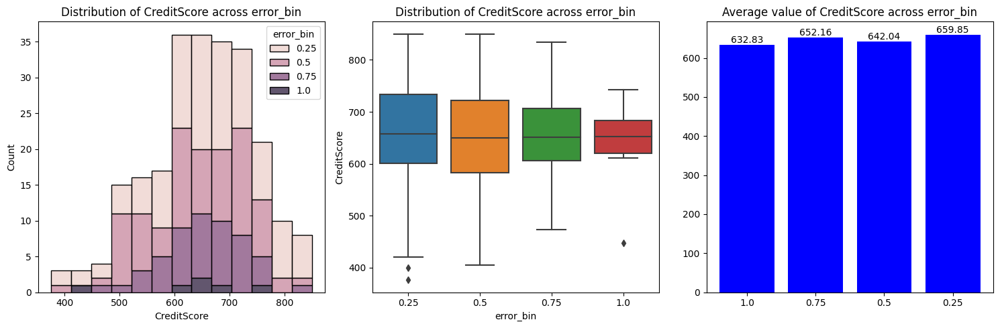

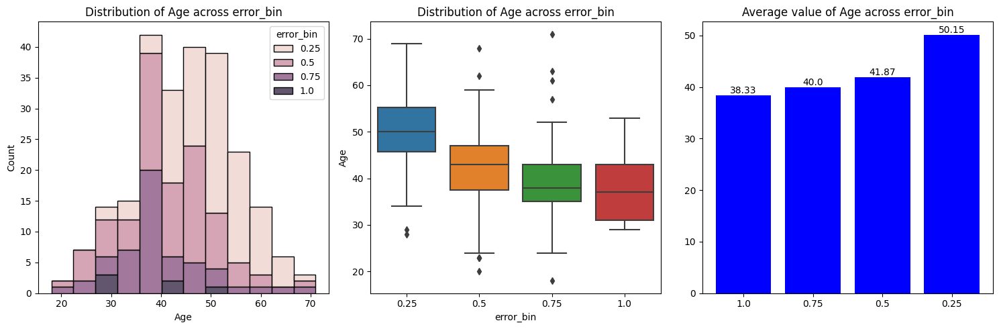

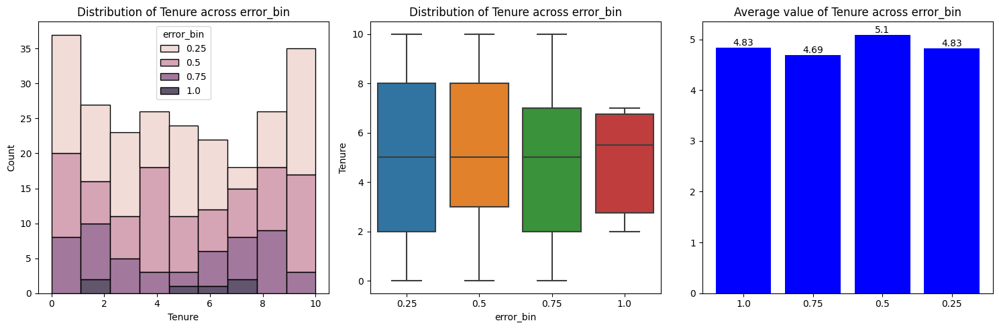

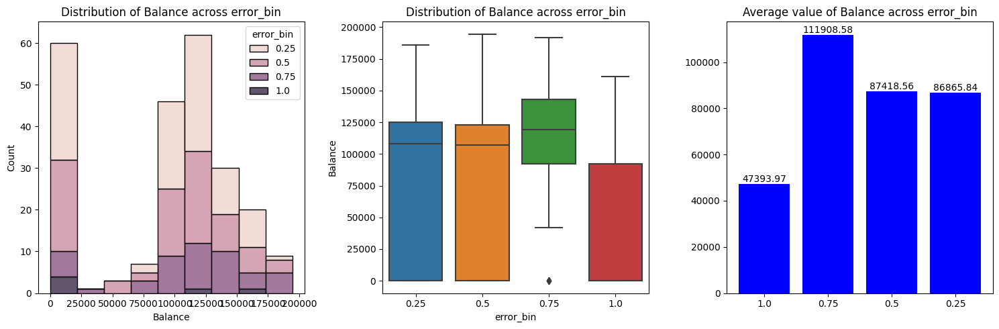

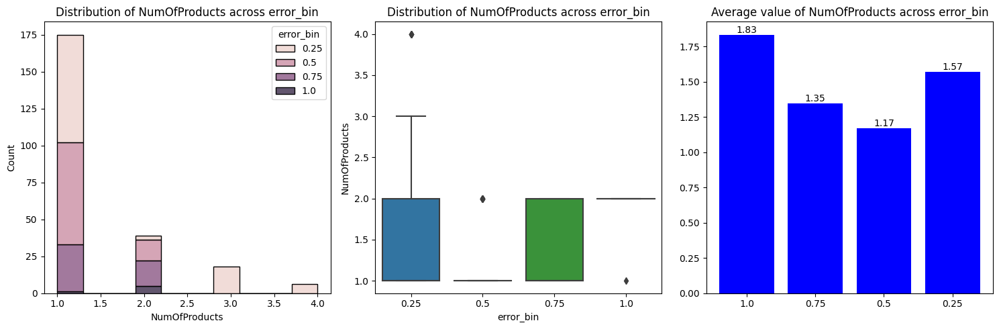

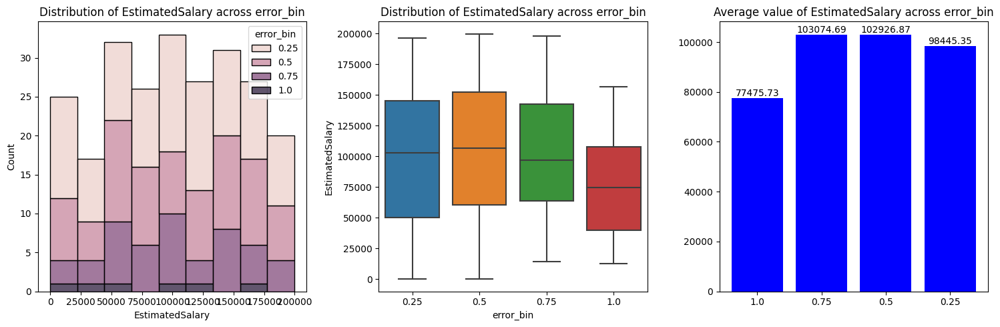

In [238]:
exited = df_ea[df_ea['Exited'] == 1]

num_feats = ['CreditScore', 'Age', 'Tenure', 'Balance', 'NumOfProducts', 'EstimatedSalary']
cat_feats = ['Geography', 'Gender', 'HasCrCard', 'IsActiveMember']

for num_feat in num_feats:
    eda_bivariate_binary_against_numerical(exited,'error_bin',num_feat)

When looking at actually exited customers, and separating between correctly and uncorrectly predicted churned customers, it seems the model tend to misclassify slightly lower income customers. And we did not use this feature in the model previously. Let's try it

#### Adding a feature to the model: Salary

In [239]:
final_features = ["Age","NumOfProducts", 'bal_per_product','tenure_age_ratio','Gender', 'Geography', 'IsActiveMember', 'Zero_Balance', 'EstimatedSalary'] 

X_final = data[final_features]
X_final.head(5)

,Age,NumOfProducts,bal_per_product,tenure_age_ratio,Gender,Geography,IsActiveMember,Zero_Balance,EstimatedSalary
0,42,1,0.000000,0.047619,Female,France,1,1,101348.88
1,41,1,83807.776192,0.024390,Female,Spain,1,0,112542.58
2,42,3,53220.248927,0.190476,Female,France,0,0,113931.57
3,39,2,0.000000,0.025641,Female,France,0,1,93826.63
4,43,1,125510.694489,0.046512,Female,Spain,1,0,79084.10


In [240]:
np.random.seed(42)

## Spot-checking in action
etc_model = {'etc_grid': etc_grid}

print('Recall metric with Salary')
results = evaluate_models(X_final, y , etc_model, metric = 'recall')
print('Recall metric without Salary')
results = evaluate_models(X_2, y , etc_model, metric = 'recall')
print('F1-score metric with Salary')
results = evaluate_models(X_final, y , etc_model, metric = 'f1')
print('F1-score metric without Salary')
results = evaluate_models(X_2, y , etc_model, metric = 'f1')

Recall metric with Salary
Model etc_grid: mean = 0.748156043744279, std_dev = 0.007142140878322362
Recall metric without Salary
Model etc_grid: mean = 0.7515934383581443, std_dev = 0.005962225704029813
F1-score metric with Salary
Model etc_grid: mean = 0.5888300349632146, std_dev = 0.005179007861555812
F1-score metric without Salary
Model etc_grid: mean = 0.5852306479622829, std_dev = 0.008183325617739667


We reduced the recall and f1 score. And it makes sense, we did not see any patterns earlier between Salary and Churn. Some inherent randomness is at fault here 

In [ ]:
not_exited = df_ea[df_ea['Exited'] == 0]

num_feats = ['CreditScore', 'Age', 'Tenure', 'Balance', 'NumOfProducts', 'EstimatedSalary']
cat_feats = ['Geography', 'Gender', 'HasCrCard', 'IsActiveMember']

for num_feat in num_feats:
    eda_bivariate_binary_against_numerical(not_exited,'error_bin',num_feat)

#### Tweaking the threshold

It seems that slighly reducing the threshold will highly increase recall while not harming precision too much, and is promising in improving overall recall and f1 score

<AxesSubplot:xlabel='y_pred_prob', ylabel='Density'>

<AxesSubplot:xlabel='y_pred_prob', ylabel='Density'>

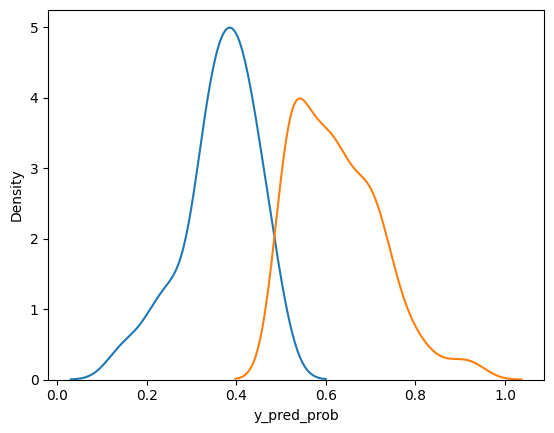

In [253]:
## Prediction probabilty distribution of errors causing low recall
sns.distplot(low_recall.y_pred_prob, hist=False)
## Prediction probabilty distribution of errors causing low precision
sns.distplot(low_prec.y_pred_prob, hist=False)

In [269]:
thresholds = [0.4,0.42,0.44,0.46,0.48, 0.52, 0.54, 0.56, 0.58, 0.6]

## Predict on validation set with adjustable decision threshold
for threshold in thresholds:
    print(threshold)
    probs = final_model.predict_proba(X_2_val)[:,1]
    val_preds = np.where(probs > threshold, 1, 0)

    ## Default params : 0.5 threshold
    confusion_matrix(y_val, val_preds)
    print(classification_report(y_val, val_preds))

0.4


array([[563, 279],
       [ 34, 204]])

              precision    recall  f1-score   support

           0       0.94      0.67      0.78       842
           1       0.42      0.86      0.57       238

    accuracy                           0.71      1080
   macro avg       0.68      0.76      0.67      1080
weighted avg       0.83      0.71      0.73      1080

0.42


array([[588, 254],
       [ 43, 195]])

              precision    recall  f1-score   support

           0       0.93      0.70      0.80       842
           1       0.43      0.82      0.57       238

    accuracy                           0.73      1080
   macro avg       0.68      0.76      0.68      1080
weighted avg       0.82      0.72      0.75      1080

0.44


array([[609, 233],
       [ 46, 192]])

              precision    recall  f1-score   support

           0       0.93      0.72      0.81       842
           1       0.45      0.81      0.58       238

    accuracy                           0.74      1080
   macro avg       0.69      0.77      0.70      1080
weighted avg       0.82      0.74      0.76      1080

0.46


array([[627, 215],
       [ 49, 189]])

              precision    recall  f1-score   support

           0       0.93      0.74      0.83       842
           1       0.47      0.79      0.59       238

    accuracy                           0.76      1080
   macro avg       0.70      0.77      0.71      1080
weighted avg       0.83      0.76      0.77      1080

0.48


array([[645, 197],
       [ 53, 185]])

              precision    recall  f1-score   support

           0       0.92      0.77      0.84       842
           1       0.48      0.78      0.60       238

    accuracy                           0.77      1080
   macro avg       0.70      0.77      0.72      1080
weighted avg       0.83      0.77      0.78      1080

0.52


array([[679, 163],
       [ 63, 175]])

              precision    recall  f1-score   support

           0       0.92      0.81      0.86       842
           1       0.52      0.74      0.61       238

    accuracy                           0.79      1080
   macro avg       0.72      0.77      0.73      1080
weighted avg       0.83      0.79      0.80      1080

0.54


array([[702, 140],
       [ 69, 169]])

              precision    recall  f1-score   support

           0       0.91      0.83      0.87       842
           1       0.55      0.71      0.62       238

    accuracy                           0.81      1080
   macro avg       0.73      0.77      0.74      1080
weighted avg       0.83      0.81      0.81      1080

0.56


array([[714, 128],
       [ 78, 160]])

              precision    recall  f1-score   support

           0       0.90      0.85      0.87       842
           1       0.56      0.67      0.61       238

    accuracy                           0.81      1080
   macro avg       0.73      0.76      0.74      1080
weighted avg       0.83      0.81      0.82      1080

0.58


array([[727, 115],
       [ 84, 154]])

              precision    recall  f1-score   support

           0       0.90      0.86      0.88       842
           1       0.57      0.65      0.61       238

    accuracy                           0.82      1080
   macro avg       0.73      0.76      0.74      1080
weighted avg       0.83      0.82      0.82      1080

0.6


array([[742, 100],
       [ 91, 147]])

              precision    recall  f1-score   support

           0       0.89      0.88      0.89       842
           1       0.60      0.62      0.61       238

    accuracy                           0.82      1080
   macro avg       0.74      0.75      0.75      1080
weighted avg       0.83      0.82      0.82      1080



**We are able to go as far as 0.62 in f1 score. With a 71% recall. We may chose this threshold which is 0.54. Using 0.52, we achieve 74% recall and 0.61 f1 score. With 0,48, we achieve 78% recall and 0,6 f1 score.** 

It's up to the business to decide where to prioritise, however I am goign to choose the best recall model while keeping the f1 score on or above 0.6, and it's the model with 0.48 threshold

***We will chose the 0.48 threshold as it is able to yield a 60% f1 score while still keeping the recall satisfactorily high***

### Train final, best model ; Save model and its parameters

In [254]:
import joblib

In [258]:
best_model = etc_grid

In [259]:
best_model_pipeline = Pipeline(steps = [('categorical_encoding', CategoricalEncoder()),
                          ('classifier', best_model)
                         ])

In [260]:
## Fitting final model on train dataset
best_model_pipeline.fit(X_2_train, y_train)

Pipeline(steps=[('categorical_encoding',
                 CategoricalEncoder(cols=['Gender', 'Geography'],
                                    lcols=['Gender'], ohecols=['Geography'])),
                ('classifier',
                 ExtraTreesClassifier(class_weight={0: 1.0, 1: 3.93},
                                      criterion='entropy', max_depth=8,
                                      max_features=0.7, min_samples_leaf=20,
                                      min_samples_split=30, n_estimators=151,
                                      n_jobs=-1))])

In [263]:
# Predict target probabilities
val_probs = best_model_pipeline.predict_proba(X_2_val)[:,1]

# Predict target values on val data
val_preds = np.where(val_probs > 0.48, 1, 0) # The probability threshold can be tweaked

<AxesSubplot:>

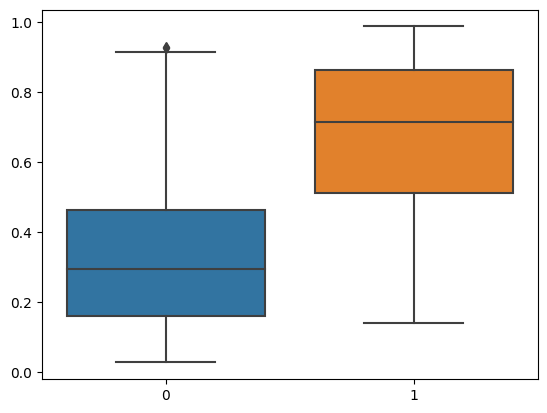

In [264]:
sns.boxplot(y_val.ravel(), val_probs)

In [265]:
## Validation metrics
roc_auc_score(y_val, val_preds)
recall_score(y_val, val_preds)
confusion_matrix(y_val, val_preds)
print(classification_report(y_val, val_preds))

0.7716720892632587

0.7773109243697479

array([[645, 197],
       [ 53, 185]])

              precision    recall  f1-score   support

           0       0.92      0.77      0.84       842
           1       0.48      0.78      0.60       238

    accuracy                           0.77      1080
   macro avg       0.70      0.77      0.72      1080
weighted avg       0.83      0.77      0.78      1080



In [268]:
## Save model object
joblib.dump(best_model_pipeline, 'final_churn_model_f1_0_48.sav')

['final_churn_model_f1_0_48.sav']

### Model interpretation attempt: SHAP

SHAP paper : https://papers.nips.cc/paper/7062-a-unified-approach-to-interpreting-model-predictions.pdf

In [270]:
import shap

shap.initjs()

In [271]:
ce = CategoricalEncoder()

X_2_encoded = ce.fit_transform(X_2_train)


In [273]:
best_model.fit(X_2_encoded, y_train)

ExtraTreesClassifier(class_weight={0: 1.0, 1: 3.93}, criterion='entropy',
                     max_depth=8, max_features=0.7, min_samples_leaf=20,
                     min_samples_split=30, n_estimators=151, n_jobs=-1)

In [274]:
X_2_encoded.head()

,Zero_Balance,Age,NumOfProducts,bal_per_product,tenure_age_ratio,Gender,IsActiveMember,Geography_Germany,Geography_France
4562,0,36,2,58932.395534,0.027778,1,0,1,0
6498,0,27,1,125167.614832,0.185185,0,0,0,1
6072,1,45,2,0.000000,0.200000,1,1,0,1
5813,1,30,2,0.000000,0.166667,1,0,0,1
7407,1,22,2,0.000000,0.181818,1,0,0,1


In [275]:
explainer = shap.TreeExplainer(best_model)

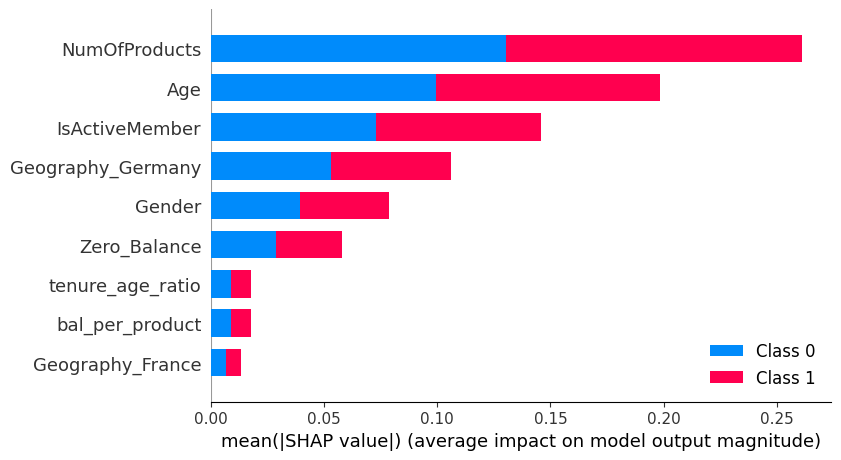

In [276]:
## Explain global patterns/ summary stats
shap_values = explainer.shap_values(X_2_encoded)
shap.summary_plot(shap_values, X_2_encoded)

### Load saved model and make predictions on unseen/future data

Here, we'll use X_2_test as the unseen, future data

In [277]:
import joblib

In [300]:
## Load model object
loaded_best_model = joblib.load('final_churn_model_f1_0_48.sav')

In [301]:
X_test = X_2_test
X_test.shape
y_test.shape

(1000, 8)

(1000,)

<AxesSubplot:ylabel='Density'>

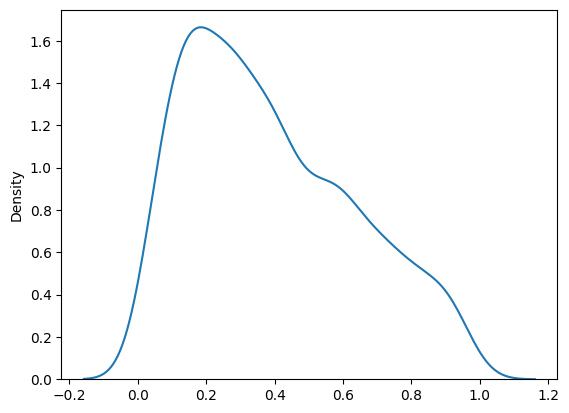

In [302]:
## Predict target probabilities
test_probs = loaded_best_model.predict_proba(X_test)[:,1]
sns.distplot(test_probs, hist=False)

In [310]:
## Predict target values on test data
test_preds = np.where(test_probs > 0.53, 1, 0) # Flexibility to tweak the probability threshold
#test_preds = model.predict(X_test)

<AxesSubplot:>

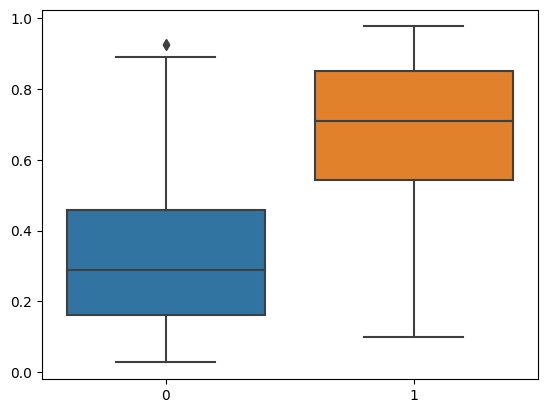

In [304]:
sns.boxplot(y_test.ravel(), test_probs)

In [311]:
## Test set metrics
roc_auc_score(y_test, test_preds)
recall_score(y_test, test_preds)
confusion_matrix(y_test, test_preds)
print(classification_report(y_test, test_preds))

0.7919640950303846

0.7643979057591623

array([[663, 146],
       [ 45, 146]])

              precision    recall  f1-score   support

           0       0.94      0.82      0.87       809
           1       0.50      0.76      0.60       191

    accuracy                           0.81      1000
   macro avg       0.72      0.79      0.74      1000
weighted avg       0.85      0.81      0.82      1000



In [313]:
## Adding predictions and their probabilities in the original test dataframe
test = X_test.copy()
test['predictions'] = test_preds
test['pred_probabilities'] = test_probs

#### Creating a list of customers who are the most likely to churn

In [315]:
high_churn_list = test[test.pred_probabilities > 0.7].sort_values(by = ['pred_probabilities'], ascending = False
                                                                 ).reset_index().drop(columns = ['index', 'predictions'], axis = 1)

In [316]:
high_churn_list.to_csv('high_churn_list.csv', index = False)

In [317]:
high_churn_list.shape
high_churn_list.head()

(143, 9)

,Zero_Balance,Age,NumOfProducts,bal_per_product,tenure_age_ratio,Gender,Geography,IsActiveMember,pred_probabilities
0,0,58,4,26614.570846,0.051724,Female,Germany,0,0.976330
1,0,45,3,29719.636760,0.066667,Female,Spain,0,0.969275
2,0,46,4,11717.604571,0.021739,Female,France,0,0.966809
3,0,51,3,35904.901365,0.019608,Male,Germany,0,0.965277
4,0,41,3,47626.744124,0.097561,Female,Spain,0,0.952579


#### Feature-based user segments from the above list
Based on business requirements, a prioritization matrix can be defined, wherein certain segments of customers are targeted first. These segments can be defined based on insights through data or the business teams' requirements.
E.g. Males who are an ActiveMember, have a CreditCard and are from Germany can be prioritized first because the business potentially sees the max. ROI from them 

#### Future steps

 - The model can be expanded to predict when will a customer churn. This will further help sales/customer service teams to reduce churn rate by targeting the right customers at the right time